# Latar Belakang

Airbnb adalah platform online yang mempertemukan pemilik properti (host) dengan tamu (guest) untuk penyewaan jangka pendek. Dengan lebih dari 4 juta host di seluruh dunia, Airbnb telah menjadi solusi populer untuk akomodasi fleksibel, menawarkan properti beragam mulai dari rumah, apartemen, hingga vila. Tidak hanya memberikan peluang pendapatan bagi host, platform ini juga menyediakan opsi akomodasi yang sering kali lebih terjangkau bagi tamu dibandingkan hotel konvensional.

Bangkok, sebagai salah satu destinasi wisata paling populer di dunia, mencatat lebih dari 22 juta kunjungan wisatawan internasional pada 2022. Kota ini menawarkan berbagai atraksi mulai dari budaya, kuliner, hingga berbagai hiburan, menjadikannya pasar yang dinamis untuk layanan Airbnb. Tren akomodasi di Bangkok mencerminkan preferensi wisatawan terhadap lokasi strategis, harga yang kompetitif, dan kenyamanan. Selain itu, dampak pandemi COVID-19 telah mengubah pola permintaan sewa, dengan lonjakan pemesanan jangka pendek pasca-pandemi.

Melalui analisis data listing Airbnb di Bangkok dari 2012 hingga 2022, penelitian ini bertujuan untuk mengidentifikasi distribusi wilayah, pola ketersediaan properti, preferensi tipe kamar, tren harga, tren waktu, dan popularitas host. Hasil analisis ini diharapkan dapat memberikan rekomendasi actionable bagi host untuk mengoptimalkan strategi mereka dalam menarik tamu, sekaligus menawarkan insight bagi industri pariwisata di kota ini.

## Referensi

Data dihimpun dari list Airbnb Bangkok, Thailand, yang dapat diakses [di sini](https://drive.google.com/drive/folders/1A_KBMRFTS5Mthpp46nulso679ML4ZwTF) selama periode 15 Desember 2012 hingga 28 Desember 2022.

## Pernyataan Masalah

Studi ini bertujuan untuk menganalisis berbagai faktor yang memengaruhi tingkat penyewaan dan profitabilitas host di platform Airbnb. Faktor-faktor tersebut mencakup ulasan pelanggan, lokasi properti, tipe properti, aturan minimum malam, harga sewa, serta tren musiman.

Fokus utama adalah:
1. Analisis jumlah dan sebaran listing melalui **pendekatan lokasi/wilayah**, bagaimana distribusi listing dan apakah sudah merata di seluruh wilayah?
2. Preferensi tamu terhadap tipe kamar yang disediakan oleh para host dengan **pendekatan Room Type**, bagaimana preferensi tamu terhadap tipe kamar yang tersedia?
3. Faktor yang memengaruhi harga listing dengan **pendekatan harga** dan apakah ada korelasi dengan faktor lain?
4. Tren waktu dari tahun ke tahun melalui **pendekatan waktu**, apakah ada tren khusus yang dapat mengoptimalisasi jumlah penyewa?
5. Analisis mengenai hubungan antara popularitas host dengan jumlah sewa dengan **pendekatan Host**, apakah host yang sudah memiliki banyak review akan mendapatkan jumlah review yang lebih banyak juga dibanding yang lain?
6. Analisis mengenai ketersediaan listing melalui **pendekatan Availability**, tipe room mana yang paling sering disewa dilihat dari jumlah ketersediaan?
7. Analisis mengenai aturan minimum night yang diterapkan di tiap listing menggunakan **pendekatan Minimum Nights**, para tamu lebih sering memilih listing dengan aturan minimum berapa?


Melalui analisis ini, diharapkan dapat dihasilkan insight yang mendalam dan actionable bagi host untuk meningkatkan profitabilitas mereka dengan optimalisasi strategi penyewaan.


## Tujuan Analisis

1. Menganalisis distribusi listing Airbnb di Bangkok guna mengidentifikasi konsentrasi properti di lokasi tertentu.
2. Mengkaji preferensi tipe kamar untuk mengoptimalkan portofolio properti dan meningkatkan efektivitas strategi pemasaran.
3. Meneliti faktor-faktor yang memengaruhi harga listing untuk mengembangkan strategi penetapan harga dan pemasaran yang lebih efektif.
4. Mengamati tren perubahan jumlah listing Airbnb di Bangkok dari waktu ke waktu untuk memprediksi dan merespons dinamika pasar.
5. Meningkatkan popularitas host lain agar dapat menyewakan list propertinya dengan strategi yang tepat.
6. Mengetahui preferensi tamu untuk tipe room yang paling sering disewa sebagai bahan pertimbangan host lain.
7. Menganalisis aturan minimum night yang populer untuk bisa diterapkan ke listing yang masih belum populer.



# Data

In [72]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import folium

from scipy import stats
import statsmodels.api as sm

import datetime

import warnings
warnings.filterwarnings('ignore')

import plotly.express as px

import folium
import json

Dataset ini mencakup informasi mengenai listing Airbnb di Bangkok, seperti lokasi, jenis kamar, harga, ulasan, dan tingkat ketersediaan.
Terdapat 17 kolom dalam dataset ini, yaitu:
* unnamed
* id: Kode unik dari Airbnb untuk listing.
* name: Nama listing.
* host_id: Kode unik dari Airbnb untuk host/pengguna.
* host_name: Nama host (biasanya hanya nama depan).
* neighbourhood: Lingkungan tempat listing berada, dikodekan berdasarkan geolokasi menggunakan latitude dan longitude.
* latitude: informasi lokasi di peta
* longitude: informasi lokasi di peta
* room_type: Jenis kamar yang termasuk dalam kategori berikut:
    • Entire place
    • Private room
    • Shared room 
* price: Harga harian dalam mata uang lokal.
* minimum_nights: Jumlah malam minimum untuk menginap (aturan kalender dapat berbeda).
* number_of_reviews: Jumlah review yang dimiliki listing ini.
* last_review: Tanggal review terakhir.
* reviews_per_month: Review per bulan.
* calculated_host_listings_count: Jumlah listing yang dimiliki host di geografi kota/region saat ini.
* availability_365: Ketersediaan listing dalam 365 hari ke depan. Listing dapat tersedia karena telah dipesan tamu atau diblokir oleh host.
* number_of_reviews_ltm: Jumlah review yang diterima listing dalam 12 bulan terakhir.

Berikut 5 baris teratas dan terbawah:

In [73]:
df = pd.read_csv("Airbnb Listings Bangkok.csv")
display(df.head(), df.tail())

,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
0,0,27934,Nice room with superb city view,120437,Nuttee,Ratchathewi,13.75983,100.54134,Entire home/apt,1905,3,65,2020-01-06,0.50,2,353,0
1,1,27979,"Easy going landlord,easy place",120541,Emy,Bang Na,13.66818,100.61674,Private room,1316,1,0,NaN,NaN,2,358,0
2,2,28745,modern-style apartment in Bangkok,123784,Familyroom,Bang Kapi,13.75232,100.62402,Private room,800,60,0,NaN,NaN,1,365,0
3,3,35780,Spacious one bedroom at The Kris Condo Bldg. 3,153730,Sirilak,Din Daeng,13.78823,100.57256,Private room,1286,7,2,2022-04-01,0.03,1,323,1
4,4,941865,Suite Room 3 at MetroPoint,610315,Kasem,Bang Kapi,13.76872,100.63338,Private room,1905,1,0,NaN,NaN,3,365,0


,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
15849,15849,790465040741092826,素坤逸核心两房公寓42楼，靠近BTSon nut/无边天际泳池观赏曼谷夜景/出门当地美食街,94899359,Renee,Pra Wet,13.715132,100.653458,Private room,2298,28,0,NaN,NaN,1,362,0
15850,15850,790474503157243541,Euro LuxuryHotel PratunamMKt TripleBdNrShopingArea,491526222,Phakhamon,Ratchathewi,13.753052,100.538738,Private room,1429,1,0,NaN,NaN,14,365,0
15851,15851,790475335086864240,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.753169,100.538700,Private room,1214,1,0,NaN,NaN,14,365,0
15852,15852,790475546213717328,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.754789,100.538757,Private room,1214,1,0,NaN,NaN,14,365,0
15853,15853,790476492384199044,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.752960,100.540820,Private room,1214,1,0,NaN,NaN,14,365,0


## Data Understanding


Langkah selanjutnya adalah Data Undesrstanding dan Cleaning. 

Pada tahap ini, kita akan mengevaluasi kelengkapan data, menganalisis statistik deskriptif, serta mengidentifikasi missing values dan data duplikat. Kemudian, kita akan menangani missing values dengan mengganti nilai yang hilang atau menghapus baris atau kolom yang tidak relevan untuk analisis, serta mengelola data duplikat.

In [74]:
print(f"Jumlah baris dan kolom dari dataset tersebut adalah {df.shape}\n")

df.info()

Jumlah baris dan kolom dari dataset tersebut adalah (15854, 17)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15854 entries, 0 to 15853
Data columns (total 17 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Unnamed: 0                      15854 non-null  int64  
 1   id                              15854 non-null  int64  
 2   name                            15846 non-null  object 
 3   host_id                         15854 non-null  int64  
 4   host_name                       15853 non-null  object 
 5   neighbourhood                   15854 non-null  object 
 6   latitude                        15854 non-null  float64
 7   longitude                       15854 non-null  float64
 8   room_type                       15854 non-null  object 
 9   price                           15854 non-null  int64  
 10  minimum_nights                  15854 non-null  int64  
 11  number_of_reviews           

Data Kategori:
* name
* host_name
* neighbourhood
* room_type
* last_review

Data Numerik:
* Unnamed
* id
* host_id
* latitude
* longitude
* price
* minimum_nights
* number_of_reviews
* reviews_per_month
* calculated_host_listings_count
* availability_365
* number_of_reviews_ltm

Data berdimensi `15854` baris dan `17` kolom.
Terdapat kolom `unnamed` yang akan dihapus karena tidak relevan untuk keperluan analisis berikutnya dan tipe data dari kolom `last_review` akan diubah ke tipe data Datetime untuk keperluan analisis.



In [75]:
# statistika deskriptif
display(df.describe(), df.describe(include='object'))

,Unnamed: 0,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
count,15854.000000,1.585400e+04,1.585400e+04,15854.000000,15854.000000,1.585400e+04,15854.000000,15854.000000,10064.000000,15854.000000,15854.000000,15854.000000
mean,7926.500000,1.579397e+17,1.541058e+08,13.745144,100.559903,3.217704e+03,15.292355,16.654157,0.813145,13.889618,244.378643,3.481519
std,4576.799919,2.946015e+17,1.318726e+08,0.043040,0.050911,2.497212e+04,50.815020,40.613331,1.090196,30.269848,125.843224,8.916937
min,0.000000,2.793400e+04,5.892000e+04,13.527300,100.329550,0.000000e+00,1.000000,0.000000,0.010000,1.000000,0.000000,0.000000
25%,3963.250000,2.104509e+07,3.974431e+07,13.720090,100.529690,9.000000e+02,1.000000,0.000000,0.120000,1.000000,138.000000,0.000000
50%,7926.500000,3.503734e+07,1.224556e+08,13.738490,100.561415,1.429000e+03,1.000000,2.000000,0.435000,4.000000,309.000000,0.000000
75%,11889.750000,5.256154e+07,2.390547e+08,13.759497,100.585150,2.429000e+03,7.000000,13.000000,1.060000,13.000000,360.000000,3.000000
max,15853.000000,7.908162e+17,4.926659e+08,13.953540,100.923440,1.100000e+06,1125.000000,1224.000000,19.130000,228.000000,365.000000,325.000000


,name,host_name,neighbourhood,room_type,last_review
count,15846,15853,15854,15854,10064
unique,14794,5312,50,4,1669
top,New! La Chada Night Market studio 2PPL near MRT,Curry,Vadhana,Entire home/apt,2022-12-11
freq,45,228,2153,8912,189


Dari statistik deskriptif diatas dapat dilihat terdapat anomali pada kolom berikut:
* `price`, terdapat nilai minimum 0, ini tidak realistis karena tidak mungkin penginapan memberikan harga 0.
* `minimum_nights` yang memiliki nilai max 1125 yang tidak realistis dalam konteks sewa properti jangka pendek.

In [76]:
df[df['price'] == df['price'].min()]

,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
11103,11103,44563108,Somerset Maison Asoke Bangkok,360620448,Somerset Maison Asoke,Vadhana,13.73815,100.5642,Hotel room,0,1,0,NaN,NaN,1,0,0


In [77]:
# hapus baris dengan price dengan nilai nol
df.drop(index=11103, inplace=True)

Dari hasil deskripsi, ditemukan bahwa kolom 'price' ada yang memiliki harga nol (0), yang pasti tidak mungkin sebuah properti disewa dengan harga 0, jadi akan saya drop.

In [78]:
df[df['minimum_nights'] == df['minimum_nights'].max()]

,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
61,61,1041976,Long-stay special rate spacious entire floor Siam,5735895,Pariya,Parthum Wan,13.74814,100.52016,Entire home/apt,2900,1125,295,2021-08-21,2.61,3,0,0


In [79]:
# hapus baris dengan 'minimun_nights' dengan nilai 1125
df.drop(index=61, inplace=True)

Dari hasil deskripsi juga terdapat kolom 'minimum_nights' yang memiliki nilai max 1125 yang tidak realistis dalam konteks sewa properti jangka pendek, jadi akan saya drop.

In [80]:
pd.set_option('display.max_colwidth', None)

# data unik di tiap kolom
list_item = []
for col in df.columns:
    list_item.append([col, df[col].nunique(), df[col].unique()])

tabel1_desc = pd.DataFrame(columns=['Column Name', 'Number of Unique', 'Unique Sample'],
                           data=list_item)

tabel1_desc

,Column Name,Number of Unique,Unique Sample
0,Unnamed: 0,15852,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, ...]"
1,id,15852,"[27934, 27979, 28745, 35780, 941865, 1704776, 48736, 1738669, 1744248, 952677, 55681, 1765918, 55686, 59221, 959254, 62217, 1791481, 66046, 105042, 1793000, 960858, 113744, 965722, 1808600, 118118, 1816517, 969792, 121410, 145343, 973830, 156583, 1823321, 159854, 976690, 978531, 166267, 169285, 978969, 1842066, 169514, 1849029, 1862089, 985743, 988373, 172332, 1016487, 1862331, 1862377, 185364, 1887544, 1888303, 1019241, 241416, 1026451, 1028469, 1028486, 1035589, 1035640, 1897982, 296960, 1898332, 313459, 1052180, 1926489, 320014, 1933894, 1057173, 1060320, 384924, 1067748, 1077493, 1943048, 385130, 385278, 385979, 390611, 1947314, 1079039, 1086843, 393066, 397449, 405662, 1088343, 1094136, 1961981, 407381, 1975849, 1133843, 413824, 428360, 428421, 428907, 428950, 430691, 430703, 430706, 432004, 439051, 1138679, 1976962, ...]"
2,name,14792,"[Nice room with superb city view, Easy going landlord,easy place, modern-style apartment in Bangkok, Spacious one bedroom at The Kris Condo Bldg. 3, Suite Room 3 at MetroPoint, NEw Pro!! Bungalow Bkk Centre, Condo with Chaopraya River View, 1 chic bedroom apartment in BKK, Batcave, Pool view, near Chatuchak, Standard Room Decor do Hostel, Sathorn Terrace Apartment(61), 2BR apt in a cozy neighborhood, Comfy bedroom near River pier & BTS Taksin., budget hotel bangkok near subway, Deluxe Condo, Nana, Pool/GYM/Sauna, Luxury@swimpool/FreeWiFi/nearJJMkt, Nice and Quiet condo near BTS Onnut, 24Flr- 1br Apt near JJ, MRT, BTS, Central Bangkok 3 Bedroom Apartment, The Duplex - Asoke- Luxury 92sqm, New, Stylish & Luxury Studio Condo, River View - Ivy Condo (1 Bedroom), Siamese Gioia on Sukhumvit 31, Contemporary Modern Duplex-Thong Lo, Pan Dao Condo 5 min from BTS On Nut, 1 BR condominium center BKK +NETFLIX+55SQM, 1 penthouse in central Bangkok, MetroPoint Suite Room, Near Airport, Boutique Rooms Near Bangkok Airport, BangLuang House1 @ Bangkok Thailand, Studio near Chula University/Silom walk to MRT/BTS, กรองทองแมนชั่น (ลาดพร้าว 81), Deluxe one Bedroom Condo w.Pool-GYM & Sauna 8-7, Beautiful 1 BR apartment @BTS Ari, Urban Oasis in the heart of Bangkok, 1Bed apt. near Chula University/Silom, Stay at the ROARING RATCHADA!, 60 m2 apartment in Thong Lor, Bangkok, ICONSIAM River view on 49th floor, 2br apt in Sukhumvit Asoke near BTS, Self catering cozy1-bed near BTS, ❂☀☀☀Perfect Escape☀☀☀Sunny Roof EnSuite☀☀☀☀, Room with city view of BKK, BangLuang House 2@ Bangkok Thailand, Tranquility found in busy Bangkok near new skytran, Private room in Bangkok, ☞✪✪✪✪Roomy Studio 4 Family r friends✪No Stairs✪✪✪✪, ☞Downtown Central Studio-Bangkok MRT, Beautiful Wood Bangkok Resort House, ""Serviced 2 Bed Scenic SkyVillas"", Cozy 1BR rooftop (BTS Ploenchit) heart of bangkok, Chic two bedroom for Monthly rental, Sukhumvit52 near SkyTrain to BkkCBD, ♡Chic Studio, Easy Walk to Pier & BTS Taksin♡, One Bedroom Suite- WIFI- SATHORN, STUDIO RM2 - WIFI- SATHORN, Quiet Double Bed Apartment, Quiet Double Bed Apartment, Suvarnabhumi free transfer, Luxury&Comfy wthWifi walk-distance to Subwy-Malls, Apr. for rent full fur 1 bedroom, monthly, One Bed Room at Sukumvit 50 Bangkok, City View, relaxed theme & delicious food around, Ideo Blucove Sukhumvit Bangkok, 2-BR condo near BTS on Sukhumvit Rd, NewlyRenovated! 3Br,SingleHouse, Park/BTS/Airport., IdeoMix, Sukhumvit RD, close to BTS, Mix Dorm Decor do Hostel, Oasis in the heart of Bangkok, 5 mins by car from Chong Nonsi BTS Station, Inn Saladaeng - Superior hotel room, Best nr Chatujak, MRT, BTS free wifi&fNetflix, 

Secara umum ada beberapa yang dapat di-highlight bahwa:

* `neighbourhood`, lokasi listing ada di 50 lokasi area Bangkok
* `room_type`, memiliki 4 kategori room
* `price`, ada 3.039 harga berbeda, menunjukkan variasi harga yang cukup luas diantara listimg
* `minimum_nights`, ada 85 nilai berbeda yang menunjukkan bahwa aturan menginap bervariasi
* `host_id` (6.658 unik) dan `host_name` (5.311 unik): Indikasi beberapa host mungkin memiliki banyak properti

## Data Cleaning

A. Find Duplicate

Tidak ada data duplikat

In [81]:
df.duplicated().sum()

np.int64(0)

B. Missing Value

Cek missing value beserta sebaran dan lanjut handle missing value tersebut

In [82]:
df.isna().sum()

Unnamed: 0                           0
id                                   0
name                                 8
host_id                              0
host_name                            1
neighbourhood                        0
latitude                             0
longitude                            0
room_type                            0
price                                0
minimum_nights                       0
number_of_reviews                    0
last_review                       5789
reviews_per_month                 5789
calculated_host_listings_count       0
availability_365                     0
number_of_reviews_ltm                0
dtype: int64

Kolom yang memiliki data kosong (NaN):
1. name (NaN = 8)
2. host_name (NaN = 1)
3. last_review (NaN = 5789)
4. reviews_per_month (NaN = 5789)

In [83]:
# Persentase missing value di setiap kolom
df.isna().sum()/df.shape[0]*100

Unnamed: 0                         0.000000
id                                 0.000000
name                               0.050467
host_id                            0.000000
host_name                          0.006308
neighbourhood                      0.000000
latitude                           0.000000
longitude                          0.000000
room_type                          0.000000
price                              0.000000
minimum_nights                     0.000000
number_of_reviews                  0.000000
last_review                       36.519051
reviews_per_month                 36.519051
calculated_host_listings_count     0.000000
availability_365                   0.000000
number_of_reviews_ltm              0.000000
dtype: float64

In [84]:
nan_match = (df['reviews_per_month'].isna() == df['last_review'].isna()).all()
print(f"Apakah semua NaN di 'reviews_per_month' sama dengan 'last_review'? {nan_match}")

Apakah semua NaN di 'reviews_per_month' sama dengan 'last_review'? True


Berikut yang dapat disimpulkan dari persentase missing value diatas adalah:
* `name` memiliki proporsi yang sangat kecil, yaitu 5.05%
* `host_name` memiliki proporsi yang sangat kecil, yaitu 0.63%
* `last_review` berkaitan dengan `reviews_per_month`, jika data di kolom `reviews_per_month` bernilai 0 (tidak ada review), maka data di `last_review` juga bernilai 0.
* persentase missing value pada kolom `last_review` dan kolom `reviews_per_month` memiliki persentase yang sama yaitu 36.52%, ini menunjukkan bahwa banyak entri data yang tidak memilik ulasan terakhir atau ulasan per bulan, dan kolom ini berkaitan.

Ada 2 cara untuk menangani missing values:
* Pertama, mengahapus baris dan kolom yang berisi missing value, tapi cara ini umumnya tidak disarankan apabila jumlah missing value tergolong cukup tinggi (dalam kasus ini mencapai 36% data)
* Kedua, mengisi missing value. Cara ini lebih disarankan karena tidak mengurangi jumlah data. Cara ini bisa digunakan untuk kolom `name` mencari kaitannya dengan kolom `calculated_host_listings_count`, dan kolom `host_name` bisa diisi dengan 'No Name'

a. Handle `name` dan `host_name`

In [85]:
df[df['name'].isna()]

,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
439,439,4549768,NaN,18852579,Titawan,Phra Khanong,13.69406,100.59619,Private room,1080,5,0,NaN,NaN,1,365,0
544,544,4720818,NaN,24386225,Cherry,Din Daeng,13.77562,100.57346,Private room,1200,1,0,NaN,NaN,1,365,0
572,572,4245018,NaN,22030043,Parichart,Bang Phlat,13.78376,100.49821,Private room,1200,1,0,NaN,NaN,1,365,0
669,669,6148415,NaN,31895202,Chira,Bang Na,13.68276,100.60894,Entire home/apt,2424,2,0,NaN,NaN,1,365,0
1030,1030,8055144,NaN,42521288,Nantida,Vadhana,13.74126,100.55761,Private room,5000,3,0,NaN,NaN,1,365,0
1282,1282,10000742,NaN,51374914,Diamond Bangkok,Ratchathewi,13.75328,100.52928,Private room,930,1,6,2017-05-13,0.07,1,365,0
1594,1594,10710165,NaN,55347997,Khaneungnit,Vadhana,13.71757,100.60464,Private room,1000,1,0,NaN,NaN,1,365,0
2075,2075,13142743,NaN,73275200,Pakaphol,Khlong Toei,13.72566,100.56416,Private room,850,1,2,2017-12-11,0.03,3,220,0


In [86]:
pakaphol = df[df['host_name'] == 'Pakaphol'][['name', 'calculated_host_listings_count', 'room_type']]
print(pakaphol)

                    name  calculated_host_listings_count     room_type
1981  Errday Guest House                               3  Private room
1982  Errday Guest House                               3  Private room
2075                 NaN                               3  Private room


saat cek kolom `calculated_host_listing`, untuk `host_name` 'Pakaphol' ada list lain yang bisa kita cek kolom `name` dari 2 data yang lain, dan ditemukan bahwa `name` untuk 'Pakhapol' bisa diisi dengan 'Errday Guest House'

In [87]:
# Mengisi kolom 'name' yang NaN untuk host_name 'Pakaphol' dengan 'Errday Guest House'
df.loc[(df['host_name'] == 'Pakaphol') & (df['name'].isna()), 'name'] = 'Errday Guest House'

Karena data `name` dan `host_name` tidak ditemukan kaitannya seperti data 'Pakaphol' sebelumnya, maka akan diganti dengan nilai 'Unknown'.

In [88]:
df.fillna({'name':'No Name'},inplace=True)
df.fillna({'host_name':'No Name'},inplace=True)

b. handle `last_review` dan `reviews_per_month`

In [89]:
# Hubungan number_of_reviews, last_review, dan reviews_per_month
df[df['number_of_reviews'] != 0][['number_of_reviews', 'last_review', 'reviews_per_month']]

,number_of_reviews,last_review,reviews_per_month
0,65,2020-01-06,0.50
3,2,2022-04-01,0.03
5,19,2017-08-03,0.17
6,1,2014-02-03,0.01
8,10,2016-03-29,0.09
...,...,...,...
15712,1,2022-12-25,1.00
15728,1,2022-12-26,1.00
15743,3,2022-12-24,3.00
15744,3,2022-12-28,3.00


In [90]:
df[df['number_of_reviews'] == 0][['number_of_reviews', 'last_review', 'reviews_per_month']]

,number_of_reviews,last_review,reviews_per_month
1,0,NaN,NaN
2,0,NaN,NaN
4,0,NaN,NaN
7,0,NaN,NaN
14,0,NaN,NaN
...,...,...,...
15849,0,NaN,NaN
15850,0,NaN,NaN
15851,0,NaN,NaN
15852,0,NaN,NaN


Dari data diatas dapat dilihat bahwa kolom last_review dan reviews_per_month yang kosong karena memang belum pernah mendapat review (number_of_reviews = 0)

Jadi saya akan mengisi missing value untuk kolom last_review dan reviews_per_month dengan '0'

In [91]:
# Mengisi NaN di kolom last_review
df['last_review'].fillna(0, inplace=True)
df[df['last_review'] == 0][['number_of_reviews', 'last_review']]

,number_of_reviews,last_review
1,0,0
2,0,0
4,0,0
7,0,0
14,0,0
...,...,...
15849,0,0
15850,0,0
15851,0,0
15852,0,0


In [92]:
# Mengisi NaN di kolom last_review
df['reviews_per_month'].fillna(0, inplace=True)
df[df['reviews_per_month'] == 0][['last_review', 'reviews_per_month']]

,last_review,reviews_per_month
1,0,0.0
2,0,0.0
4,0,0.0
7,0,0.0
14,0,0.0
...,...,...
15849,0,0.0
15850,0,0.0
15851,0,0.0
15852,0,0.0


In [93]:
df.isna().sum()

# saat dicek ulang, sudah tidak ada missing value lagi

Unnamed: 0                        0
id                                0
name                              0
host_id                           0
host_name                         0
neighbourhood                     0
latitude                          0
longitude                         0
room_type                         0
price                             0
minimum_nights                    0
number_of_reviews                 0
last_review                       0
reviews_per_month                 0
calculated_host_listings_count    0
availability_365                  0
number_of_reviews_ltm             0
dtype: int64

In [94]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 15852 entries, 0 to 15853
Data columns (total 17 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Unnamed: 0                      15852 non-null  int64  
 1   id                              15852 non-null  int64  
 2   name                            15852 non-null  object 
 3   host_id                         15852 non-null  int64  
 4   host_name                       15852 non-null  object 
 5   neighbourhood                   15852 non-null  object 
 6   latitude                        15852 non-null  float64
 7   longitude                       15852 non-null  float64
 8   room_type                       15852 non-null  object 
 9   price                           15852 non-null  int64  
 10  minimum_nights                  15852 non-null  int64  
 11  number_of_reviews               15852 non-null  int64  
 12  last_review                     15852

c. Drop unnecessary columns

Lalu hapus beberapa kolom yang tidak diperlukan dalam analisis data

In [95]:
df.drop(columns='Unnamed: 0', inplace=True)

In [96]:
df.reset_index(drop=True, inplace=True) 

## Data yang sudah bersih

In [97]:
listItem = []
for col in df.columns :
    listItem.append([col, df[col].dtype, df[col].isna().sum(),
                    df[col].nunique(), list(df[col].drop_duplicates().sample(2).values)]);

dfDesc = pd.DataFrame(columns=['dataFeatures', 'dataType', 'null', 'unique', 'uniqueSample'],
                     data=listItem)
print(df.shape)
dfDesc

(15852, 16)


,dataFeatures,dataType,null,unique,uniqueSample
0,id,int64,0,15852,"[745386732424937266, 28470664]"
1,name,object,0,14793,"[Condo 1bd near Central3,Sathon,high fl, True Siam Phayathai near BTS and Airport Link]"
2,host_id,int64,0,6658,"[124981113, 61895330]"
3,host_name,object,0,5312,"[Siripassorn, Natapol]"
4,neighbourhood,object,0,50,"[Chom Thong, Thon buri]"
5,latitude,float64,0,9606,"[13.700905124876677, 13.77033]"
6,longitude,float64,0,10224,"[100.57818204073592, 100.56424]"
7,room_type,object,0,4,"[Entire home/apt, Hotel room]"
8,price,int64,0,3039,"[6541, 2229]"
9,minimum_nights,int64,0,85,"[170, 160]"


Sebelum dibersihkan, data memiliki `15854` baris dan `17` kolom dengan kolom yang memiliki data kosong (NaN):
1. name (NaN = 8)
2. host_name (NaN = 1)
3. last_review (NaN = 5789)
4. reviews_per_month (NaN = 5789)

Setelah dibersihkan, data berkurang 2 baris (price nol dan minimum night 1.125), dan sisa data kosong diisi dengan data yang relevan sehingga menjadi memiliki `15852`, dan kolom berkurang 1 menjadi 16. Nilai kosong dan duplikat sudah tidak ada pada data.

## Outliers

array([[<Axes: title={'center': 'id'}>,
        <Axes: title={'center': 'host_id'}>,
        <Axes: title={'center': 'latitude'}>],
       [<Axes: title={'center': 'longitude'}>,
        <Axes: title={'center': 'price'}>,
        <Axes: title={'center': 'minimum_nights'}>],
       [<Axes: title={'center': 'number_of_reviews'}>,
        <Axes: title={'center': 'reviews_per_month'}>,
        <Axes: title={'center': 'calculated_host_listings_count'}>],
       [<Axes: title={'center': 'availability_365'}>,
        <Axes: title={'center': 'number_of_reviews_ltm'}>, <Axes: >]],
      dtype=object)

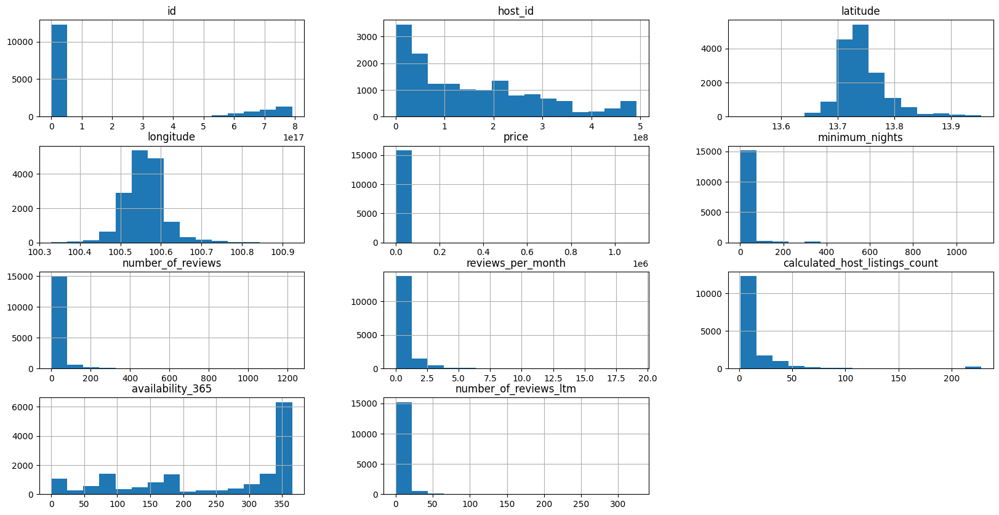

In [98]:
# cek distribusi data pada data numerik

df.hist(bins=15, figsize=(20,10))


Berdasarkan histogram yang ditampilkan, sebagian besar data dalam dataset ini menunjukkan distribusi yang miring atau terkonsentrasi pada nilai-nilai tertentu dan tidak berdistribusi normal. Hal ini akan menjadi acuan untuk menentukan metode korelasi yang akan digunakan.

In [99]:
df.describe()

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
count,1.585200e+04,1.585200e+04,15852.000000,15852.000000,1.585200e+04,15852.000000,15852.000000,15852.000000,15852.000000,15852.000000,15852.000000
mean,1.579596e+17,1.541021e+08,13.745144,100.559905,3.217927e+03,15.223253,16.637648,0.516079,13.891118,244.409475,3.481958
std,2.946148e+17,1.318655e+08,0.043042,0.050913,2.497368e+04,50.047830,40.555459,0.952659,30.271461,125.821219,8.917414
min,2.793400e+04,5.892000e+04,13.527300,100.329550,2.780000e+02,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000
25%,2.104509e+07,3.974431e+07,13.720087,100.529690,9.000000e+02,1.000000,0.000000,0.000000,1.000000,138.000000,0.000000
50%,3.503734e+07,1.224556e+08,13.738490,100.561415,1.429000e+03,1.000000,2.000000,0.090000,4.000000,309.000000,0.000000
75%,5.256602e+07,2.390365e+08,13.759505,100.585150,2.429000e+03,7.000000,13.000000,0.670000,13.000000,360.000000,3.000000
max,7.908162e+17,4.926659e+08,13.953540,100.923440,1.100000e+06,1115.000000,1224.000000,19.130000,228.000000,365.000000,325.000000


Dari data yang deskriptif, dapat diambil beberapa poin yaitu:
* Q3 pada kolom `price` memiliki nilai 24.290 Baht, tapi pada maksimumnya memiliki harga di 1.100.000 Baht, sehingga sangat jelas terdapat outliers, namun ini bisa terjadi untuk akomodasi dengan tingkat luxury.
* Pada analisis ini rata-rata kebanyakan kolom memiliki nilai outliers berguna sebagai acuan untuk **menggunakan median** daripada mean, karena median lebih tahan terhadap pengaruh outliers. Hal ini direkomendasikan dari referensi berikut tentang penggunaan mean, median, dan modus terhadap outliers [di sini](https://yudopr.dev/blog/ukuran-pemusatan-data/). 

In [100]:
df.head()

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
0,27934,Nice room with superb city view,120437,Nuttee,Ratchathewi,13.75983,100.54134,Entire home/apt,1905,3,65,2020-01-06,0.50,2,353,0
1,27979,"Easy going landlord,easy place",120541,Emy,Bang Na,13.66818,100.61674,Private room,1316,1,0,0,0.00,2,358,0
2,28745,modern-style apartment in Bangkok,123784,Familyroom,Bang Kapi,13.75232,100.62402,Private room,800,60,0,0,0.00,1,365,0
3,35780,Spacious one bedroom at The Kris Condo Bldg. 3,153730,Sirilak,Din Daeng,13.78823,100.57256,Private room,1286,7,2,2022-04-01,0.03,1,323,1
4,941865,Suite Room 3 at MetroPoint,610315,Kasem,Bang Kapi,13.76872,100.63338,Private room,1905,1,0,0,0.00,3,365,0


# Data Analysis

Setelah data selesai dibersihkan, selanjutnya akan masuk ke tahap analisis dengan berbagai pendekatan, yaitu:

1. Pendekatan Lokasi/Wilayah
2. Pendekatan Room Type
3. Pendekatan Harga
4. Pendekatan Waktu
5. Pendekatan Host
6. Pendekatan Availability
7. Pendekatan Minimum Nights

Dari pendekatan yang disebutkan, diharapkan akan memberikan rekomendasi dan insight yang baik untuk peningkatan sales, trafic, dan profit.

## 1. Pendekatan Lokasi/Wilayah

In [101]:
# menghitung jumlah listing per neighbourhood
district = df.groupby('neighbourhood')['id'].count().reset_index()
district = district.rename(columns={'id': 'jumlah listing'})
district.head()

,neighbourhood,jumlah listing
0,Bang Bon,5
1,Bang Kapi,260
2,Bang Khae,92
3,Bang Khen,116
4,Bang Kho laen,140


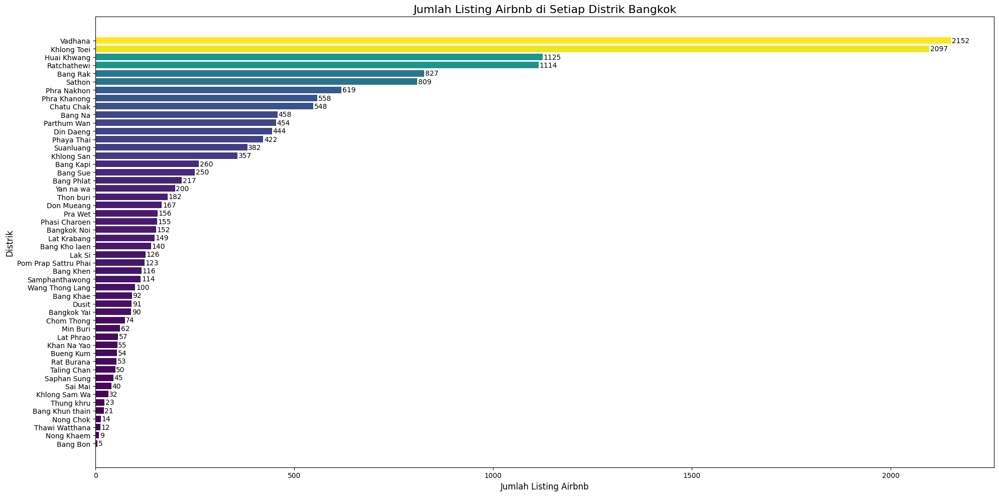

In [102]:
district_sorted = district.sort_values(by='jumlah listing', ascending=True)

plt.figure(figsize=(20, 10))
bars = plt.barh(
    y=district_sorted['neighbourhood'], 
    width=district_sorted['jumlah listing'], 
    color=plt.cm.viridis(district_sorted['jumlah listing'] / max(district_sorted['jumlah listing']))
)

for bar in bars:
    plt.text(bar.get_width() + 2, 
             bar.get_y() + bar.get_height() / 2,  
             f'{int(bar.get_width())}',  
             va='center', fontsize=10)

plt.title('Jumlah Listing Airbnb di Setiap Distrik Bangkok', fontsize=16)
plt.xlabel('Jumlah Listing Airbnb', fontsize=12)
plt.ylabel('Distrik', fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.tight_layout()

plt.show()

1. Distrik dengan Listing Terbanyak:
    * Vadhana (2152) dan Khlong Toei (2097) mendominasi jumlah listing Airbnb.
    * Alasan popularitas: Area ini termasuk pusat hiburan, restoran, dan atraksi wisata seperti Sukhumvit, yang merupakan lokasi strategis untuk turis.
    * Karakteristik: Banyak terdapat apartemen modern, akses transportasi yang baik (BTS/MRT), dan kedekatan ke pusat bisnis.

2. Distrik dengan Listing Tinggi (800-1200):
    * Huai Khwang (1125), Ratchathewi (1114), Bang Rak (827), Sathon (809):
    * Distrik ini populer untuk penginapan karena letaknya dekat dengan pusat kota, kantor, dan tempat wisata.
    * Contoh lokasi terkenal:
        - Huai Khwang: Area dengan budaya lokal dan kuliner malam.
        - Sathon: Distrik bisnis dan beberapa hotel mewah.

3. Distrik Menengah (400-600 Listing):
    * Phra Nakhon (558), Phra Khanong (548), Chatu Chak (458):
    * Distrik ini cenderung menjadi pilihan alternatif turis yang ingin menjelajahi sisi lain Bangkok.
    * Phra Nakhon, misalnya, mencakup area Khao San Road (destinasi favorit backpacker).

4. Distrik dengan Listing Rendah (<200):
    * Distrik seperti Nong Chok (14), Thawi Watthana (12), dan Nong Khaem (19) menunjukkan listing Airbnb yang sangat sedikit.
    * Alasan: Ini adalah area suburban/rural dengan akses terbatas ke tempat wisata atau fasilitas turis.

In [103]:
import folium
from folium.plugins import MarkerCluster

map_center = [df['latitude'].mean(), df['longitude'].mean()]
map = folium.Map(location=map_center, zoom_start=12)

marker_cluster = MarkerCluster().add_to(map)
for index, row in df.iterrows():
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=f"<b>{row['name']}</b><br>"
              f"Neighbourhood: {row['neighbourhood']}<br>"
              f"Price: ${row['price']}<br>"
              f"Room Type: {row['room_type']}",
        tooltip=row['name'],
        icon=folium.Icon(color="blue")
    ).add_to(marker_cluster)

map

Insight:
- Distribusi Airbnb di Bangkok terlihat cukup merata, walaupun sebarannya memang terpusat di area tengah kota
- Untuk selanjutnya akan dianalisis mengenai 10 lokasi terbaik berdasarkan jumlah review

In [104]:
# jumlah total review per neighbourhood
neighbourhood_reviews = df.groupby('neighbourhood')['number_of_reviews'].sum().sort_values(ascending=False)

# ambil 10 neighbourhood dengan jumlah review tertinggi
top_10_neighbourhoods = pd.DataFrame({
    'neighbourhood': neighbourhood_reviews.head(10).index,
    'total_reviews': neighbourhood_reviews.head(10).values
})

top_10_neighbourhoods

,neighbourhood,total_reviews
0,Khlong Toei,41281
1,Vadhana,37415
2,Sathon,22242
3,Ratchathewi,20698
4,Huai Khwang,18145
5,Bang Rak,17654
6,Phaya Thai,13659
7,Parthum Wan,8808
8,Chatu Chak,8218
9,Phra Nakhon,8142


In [105]:
bangkok = 'Bangkok-districts.geojson'
bangkok_loc = [13.759742352705317, 100.50647679596567]

with open(bangkok, 'r', encoding='utf-8') as f:
    bangkok_geojson = json.load(f)

bangkok_map = folium.Map(location=bangkok_loc, 
                         zoom_start=12, 
                         dragging=False,
                         min_zoom=10,
                         max_zoom=10,)

folium.GeoJson(bangkok_geojson).add_to(bangkok_map)

folium.Choropleth(
    geo_data=bangkok_geojson,
    data=top_10_neighbourhoods,
    columns=['neighbourhood', 'total_reviews'],
    key_on='feature.properties.dname_e',
    fill_color='YlGnBu',  # Warna yang lebih kontras
    fill_opacity=0.8,
    line_color='black',  # Menambahkan border hitam
    line_weight=1.5,
    legend_name='Top 10 Lokasi Berdasarkan Jumlah Review'
).add_to(bangkok_map)

bangkok_map


dari yang bisa kita lihat, bahwa top 10 district berdasarkan jumlah review ada di area pusat kota

## 2. Pendekatan Room Type

Lalu kita akan melihat room type apa yang paling sering disewa

In [106]:
room_type_counts = df['room_type'].value_counts()
room_type_counts = room_type_counts.reset_index()
room_type_counts.columns = ['room_type', 'count']
room_type_counts

,room_type,count
0,Entire home/apt,8911
1,Private room,5770
2,Hotel room,648
3,Shared room,523


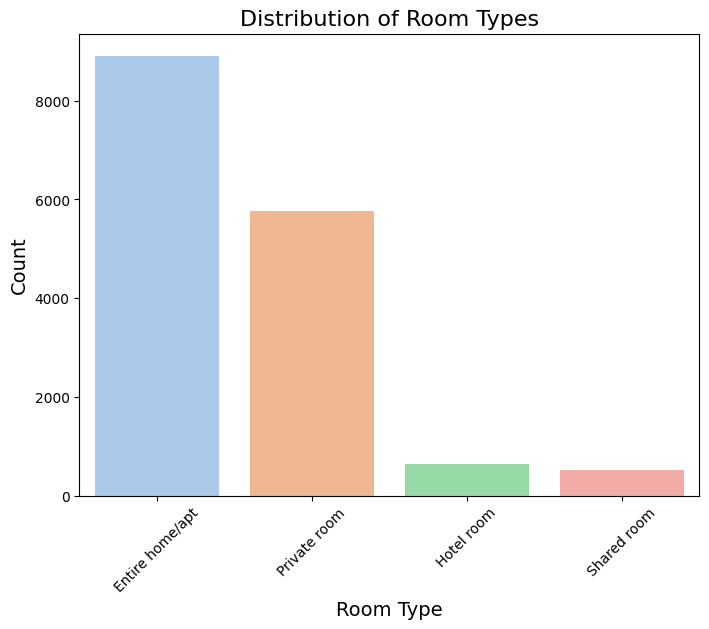

In [107]:
plt.figure(figsize=(8, 6))
sns.barplot(data=room_type_counts, x='room_type', y='count', palette='pastel')

plt.title('Distribution of Room Types', fontsize=16)
plt.xlabel('Room Type', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.xticks(rotation=45) 
plt.show()

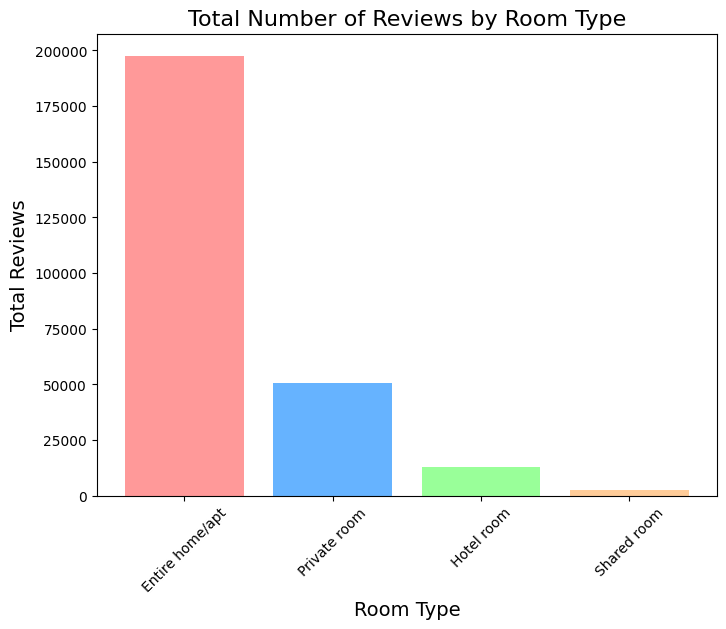

In [108]:
reviews_by_room_type = df.groupby('room_type')['number_of_reviews'].sum().reset_index()

reviews_by_room_type = reviews_by_room_type.sort_values(by='number_of_reviews', ascending=False)

plt.figure(figsize=(8, 6))
plt.bar(reviews_by_room_type['room_type'], reviews_by_room_type['number_of_reviews'], color=['#ff9999', '#66b3ff', '#99ff99', '#ffcc99'])

plt.title('Total Number of Reviews by Room Type', fontsize=16)
plt.xlabel('Room Type', fontsize=14)
plt.ylabel('Total Reviews', fontsize=14)
plt.xticks(rotation=45)
plt.show()

Insight:
- Room Type: Entire home/apt mendominasi dengan jumlah review yang sangat tinggi, jauh melebihi jenis lainnya. Ini menunjukkan bahwa tipe "Entire home/apt" sangat populer di kalangan pengguna dan kemungkinan besar memiliki banyak properti yang tersedia.
- Private room memiliki jumlah review yang lebih rendah, tetapi tetap signifikan, menunjukkan bahwa banyak tamu yang memilih jenis kamar pribadi meskipun tidak sebanyak seluruh rumah atau apartemen.
- Hotel room dan Shared room memiliki jumlah review yang jauh lebih rendah. Ini bisa menunjukkan bahwa tipe ini lebih jarang dipilih atau memiliki sedikit properti yang tersedia.

Penjelasan:
- Dominasi Entire home/apt: Biasanya, tamu lebih cenderung untuk memilih Entire home/apt karena memberikan privasi lebih dan kenyamanan untuk menginap lebih lama, terutama bagi keluarga atau kelompok.
- Private room: Bisa lebih terjangkau daripada sewa seluruh rumah, tetapi masih memberikan kenyamanan lebih daripada berbagi ruangan dengan orang lain.
- Hotel room dan Shared room: Tipe ini mungkin lebih terbatas, atau lebih banyak digunakan oleh tamu dengan anggaran lebih rendah, yang berdampak pada jumlah review yang lebih sedikit.

## 3. Pendekatan Harga

Harga berdasarkan district

In [109]:
num_neighbourhoods = df["neighbourhood"].nunique()
print(f"Jumlah Neighbourhood: {num_neighbourhoods}")

Jumlah Neighbourhood: 50


In [110]:
price_analysis = df.groupby("neighbourhood")["price"].agg(["mean", "min", "max"])

print("Analisis Harga Berdasarkan Neighbourhood:")
price_analysis.head()

Analisis Harga Berdasarkan Neighbourhood:


,mean,min,max
neighbourhood,,,
Bang Bon,1504.400000,790,2632
Bang Kapi,3082.034615,320,429443
Bang Khae,1849.739130,350,12000
Bang Khen,2194.689655,400,50000
Bang Kho laen,2408.114286,499,14630


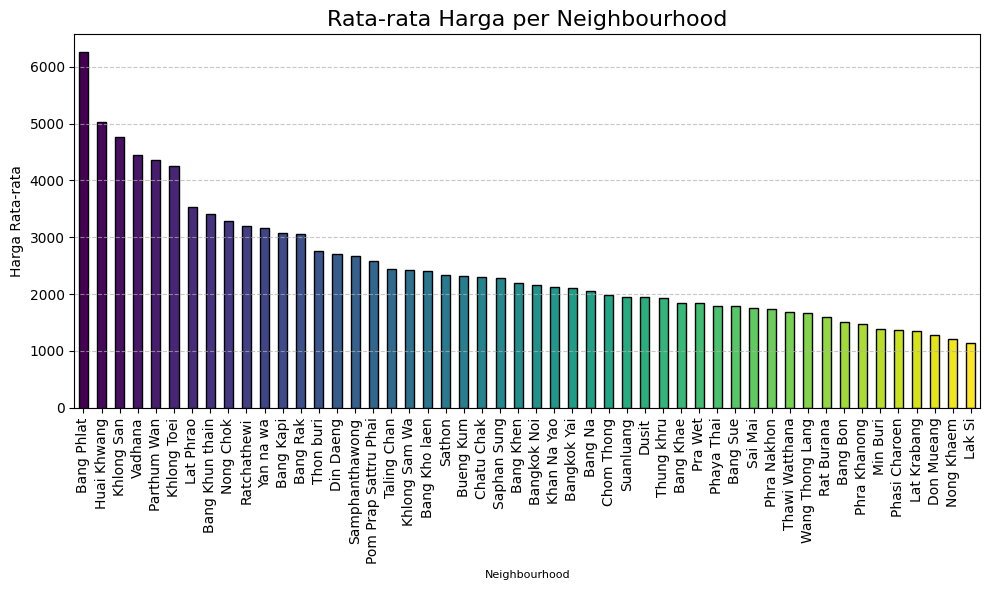

In [111]:
price_analysis.sort_values(by="mean", ascending=False, inplace=True)

colors = plt.cm.viridis(np.linspace(0, 1, len(price_analysis)))

plt.figure(figsize=(10, 6))
price_analysis["mean"].plot(kind="bar", color=colors, edgecolor="black")
plt.title("Rata-rata Harga per Neighbourhood", fontsize=16)
plt.xlabel("Neighbourhood", fontsize=8)
plt.ylabel("Harga Rata-rata", fontsize=10)
plt.xticks(rotation=90)
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.tight_layout()
plt.show()

Berdasarkan grafik tersebut, berikut adalah beberapa insight:

1. Variasi Harga Rata-rata:
- Terdapat perbedaan yang signifikan pada rata-rata harga antar neighbourhood. Bang Phlat memiliki harga rata-rata tertinggi (>6000), sementara Lak Si memiliki harga terendah (<1000).

2. Distribusi Harga:
- Sebagian besar neighbourhood memiliki harga rata-rata di bawah 3000, menunjukkan bahwa area dengan harga tinggi adalah pengecualian, bukan aturan umum.

3. Area Premium:
- Neighbourhood seperti Bang Phlat, Huai Khwang, dan Khlong San mungkin merupakan area yang populer atau memiliki fasilitas unggulan sehingga harga lebih tinggi.

4. Area Terjangkau:
- Lak Si, Nong Khaem, dan Don Mueang memiliki harga rata-rata terendah, yang mungkin menarik bagi pembeli dengan anggaran terbatas.

Harga berdasarkan room type

In [112]:
room_type_analysis = df.groupby("room_type")["price"].agg(["mean", "min", "max"])

print("\nAnalisis Harga Berdasarkan Room Type:")
room_type_analysis


Analisis Harga Berdasarkan Room Type:


,mean,min,max
room_type,,,
Entire home/apt,3465.537987,332,1100000
Hotel room,3032.983025,318,300000
Private room,3064.603640,278,600700
Shared room,919.757170,280,31200


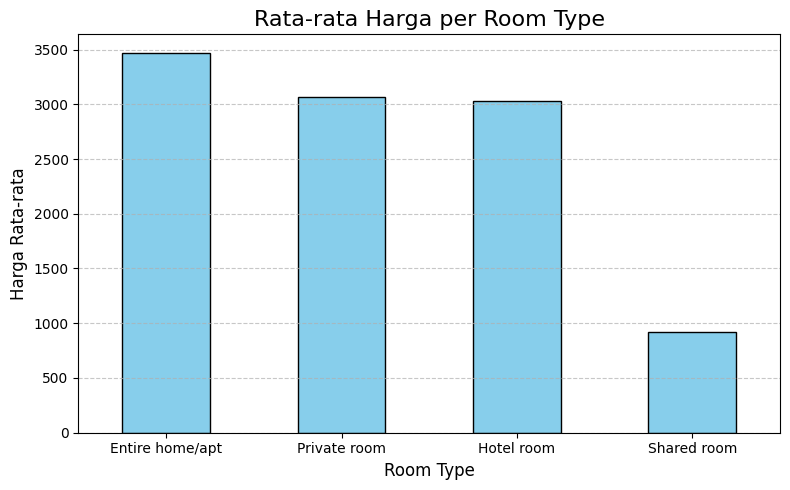

In [113]:
room_type_analysis.sort_values(by="mean", ascending=False, inplace=True)

plt.figure(figsize=(8, 5))
room_type_analysis["mean"].plot(kind="bar", color="skyblue", edgecolor="black")
plt.title("Rata-rata Harga per Room Type", fontsize=16)
plt.xlabel("Room Type", fontsize=12)
plt.ylabel("Harga Rata-rata", fontsize=12)
plt.xticks(rotation=0)
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.tight_layout()
plt.show()

* Tipe kamar Entire home/apt memiliki harga rata-rata tertinggi dibandingkan dengan tipe kamar lainnya. Ini wajar karena menawarkan seluruh tempat untuk tamu.
* Tipe kamar Private room dan Hotel room memiliki harga rata-rata yang hampir sama. Artinya, ada persaingan harga antara kamar privat dan hotel untuk pasar tertentu.
* Shared room memiliki harga rata-rata terendah, mencerminkan opsi budget-friendly yang lebih sesuai untuk wisatawan dengan anggaran terbatas.

Perbedaan harga yang signifikan antara tipe kamar tertinggi (Entire home/apt) dan terendah (Shared room) menunjukkan adanya segmentasi pasar yang jelas, dengan layanan dan privasi yang ditawarkan sebagai faktor penentu utama harga

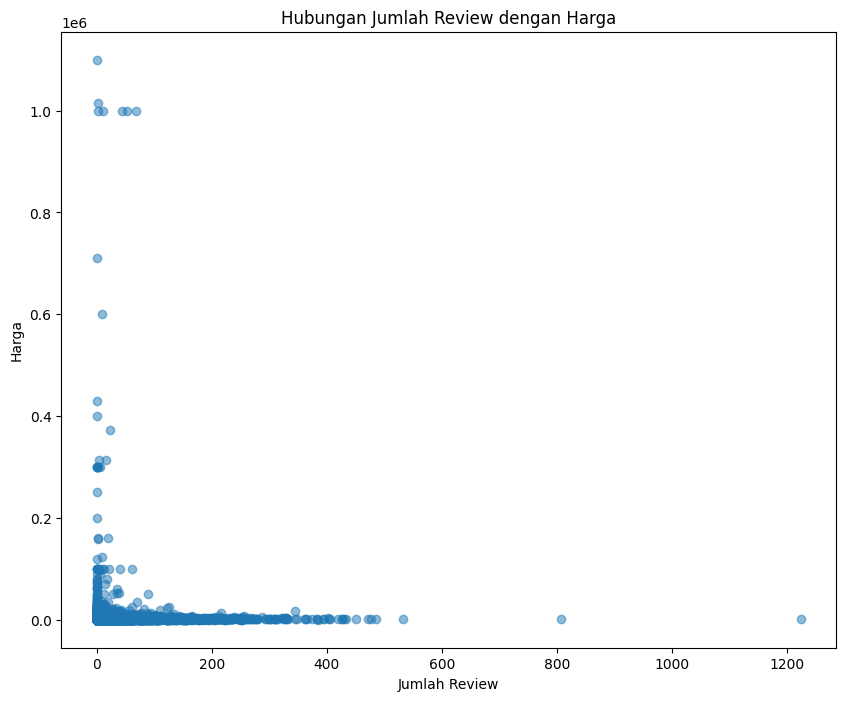

In [114]:
plt.figure(figsize=(10,8))
plt.scatter(df['number_of_reviews'], df['price'], alpha=0.5)
plt.title('Hubungan Jumlah Review dengan Harga')
plt.xlabel('Jumlah Review')
plt.ylabel('Harga')
plt.show()

Hubungan antara jumlah review dan harga listing menunjukkan bahwa sebagian besar listing dengan review terbanyak tetap memiliki harga yang rendah, ,menunjukan bahwa popularitas sebuah listing (dilihat dari jumlah ulasan) tidak berkolerasi dengan harga yang tinggi. Karena kebanyakan orang memilih akomodasi yang sesuai dengan budget mereka.

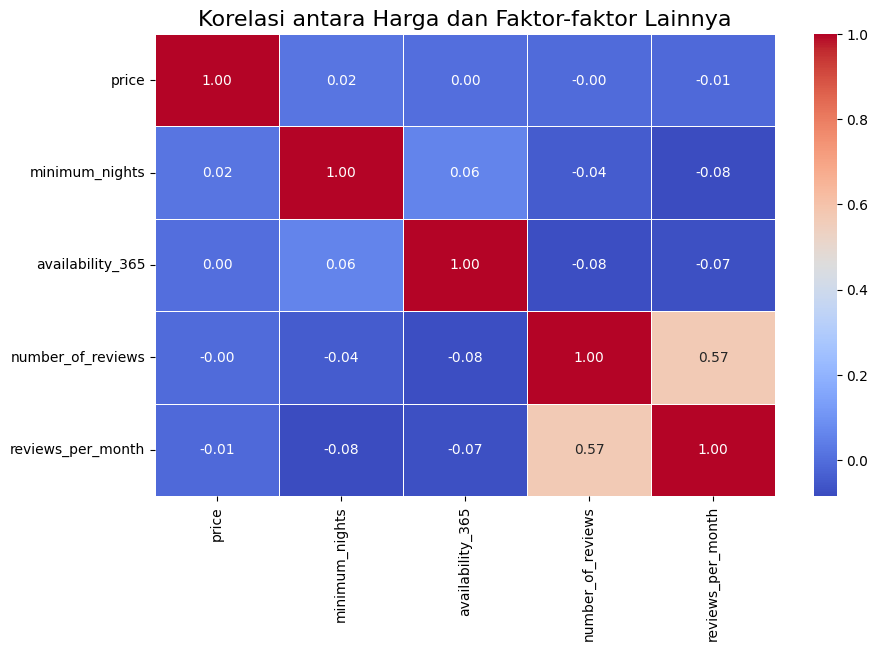

In [115]:
# # Pastikan kolom 'price' berupa numerik
# df['price'] = pd.to_numeric(df['price'], errors='coerce')

# Pilih kolom yang relevan untuk korelasi
correlation_data = df[['price', 'minimum_nights', 'availability_365', 'number_of_reviews', 'reviews_per_month']]

# Hitung korelasi
correlation_matrix = correlation_data.corr()

# Membuat heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Korelasi antara Harga dan Faktor-faktor Lainnya', fontsize=16)
plt.show()


Insight:
* Korelasi antara price dengan faktor lainnya:
Harga (price) memiliki korelasi yang sangat rendah (dekat dengan 0) terhadap semua variabel lainnya. Ini menunjukkan bahwa harga tidak dipengaruhi secara signifikan oleh variabel seperti minimum nights, availability 365, number of reviews, atau reviews per month.

* Korelasi antara jumlah ulasan dan ulasan per bulan:
Terdapat korelasi yang cukup kuat antara number_of_reviews dan reviews_per_month (r = 0.57). Hal ini logis, karena properti dengan banyak ulasan cenderung menerima ulasan secara konsisten setiap bulan.

* Korelasi antar variabel lainnya:
Korelasi antar variabel selain harga juga sangat lemah (nilai mendekati 0), seperti antara minimum nights dan availability_365. Ini menunjukkan bahwa faktor-faktor ini relatif independen satu sama lain.

* Interpretasi umum:
Variabel harga tampaknya tidak memiliki hubungan linier yang signifikan dengan variabel lainnya.

## 4. Pendekatan Waktu

Tren review dari waktu ke waktu

Tujuan: Melihat distribusi last_review untuk memahami kapan review paling banyak dibuat

In [ ]:
df['last_review'] = pd.to_datetime(df['last_review'], errors='coerce')  # Convert to datetime format
df['last_review'].min(), df['last_review'].max()

(Timestamp('2012-12-15 00:00:00'), Timestamp('2022-12-28 00:00:00'))

Dataset ini mencakup periode ulasan dari 15 Desember 2012 hingga 28 Desember 2022, berdasarkan kolom last_review

<Axes: title={'center': 'Tren Review per Tahun'}, xlabel='Tahun', ylabel='Jumlah Review'>

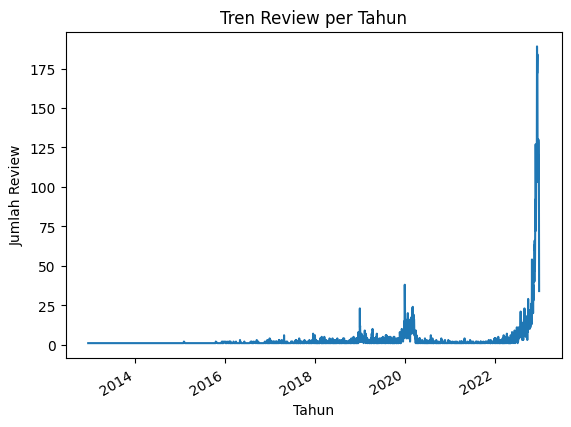

In [ ]:
df['last_review'] = df['last_review'].replace('0', pd.NaT)

df['last_review'] = pd.to_datetime(df['last_review'],errors='coerce')

review_trend = df['last_review'].value_counts().sort_index()
review_trend.plot(kind='line', title='Tren Review per Tahun', xlabel='Tahun', ylabel='Jumlah Review')


Berdasarkan grafik tren review dari waktu ke waktu, berikut adalah beberapa insight yang dapat diperoleh:

* Peningkatan Tajam di 2022:
Terlihat lonjakan signifikan jumlah review pada tahun 2022, menunjukkan peningkatan aktivitas wisatawan atau penggunaan Airbnb setelah periode stagnasi sebelumnya, mungkin terkait dengan pelonggaran pembatasan pandemi COVID-19.

* Periode Stabil Sebelumnya:
Sebelum 2020, jumlah review relatif stabil dan rendah, menandakan pertumbuhan yang lambat pada tahap awal penggunaan Airbnb di Bangkok.

* Pengaruh Pandemi (2020-2021):
Penurunan atau fluktuasi kecil selama 2020-2021 kemungkinan besar disebabkan oleh pembatasan perjalanan dan pandemi global, yang membatasi aktivitas wisatawan.

* Pertumbuhan Pasar Airbnb:
Lonjakan tajam di akhir grafik mencerminkan percepatan penggunaan Airbnb, baik karena lonjakan wisatawan domestik maupun internasional, atau popularitas platform sebagai pilihan akomodasi utama.

Kesimpulan: Grafik ini menunjukkan bahwa pasar Airbnb di Bangkok mengalami pertumbuhan pesat sejak akhir pandemi, dengan 2022 menjadi tahun pemulihan besar-besaran untuk sektor pariwisata dan akomodasi.

last_review
2022-12-11    189
2022-12-14    184
2022-12-13    179
2022-12-12    172
2022-12-10    142
2022-12-15    135
2022-12-22    130
2022-12-23    128
2022-11-30    127
2022-12-18    125
2022-12-06    123
2022-12-07    120
2022-12-26    120
2022-12-17    119
2022-12-04    117
2022-12-08    116
2022-12-16    111
2022-12-24    111
2022-12-21    110
2022-12-20    107
Name: count, dtype: int64


<Axes: title={'center': '10 Tanggal dengan Review Terbanyak'}, xlabel='Tanggal', ylabel='Jumlah Ulasan'>

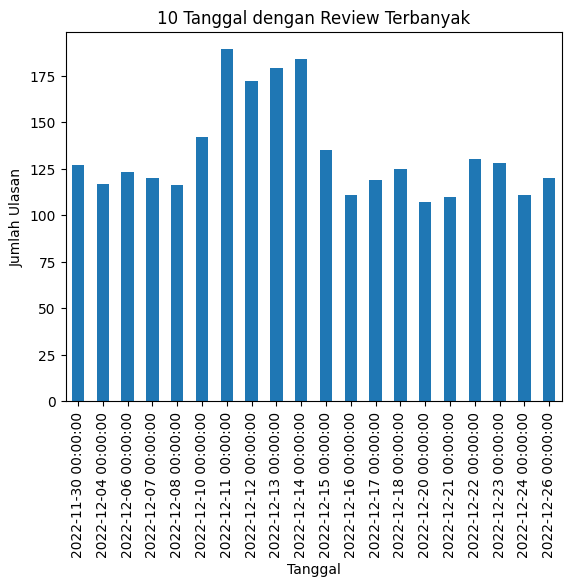

In [118]:
top_10_reviews = df["last_review"].value_counts().nlargest(20)
print(top_10_reviews)

top_10_reviews.sort_index().plot(kind="bar", title="10 Tanggal dengan Review Terbanyak", xlabel="Tanggal", ylabel="Jumlah Ulasan")

Grafik ini mengindikasikan bahwa Desember 2022 adalah periode puncak aktivitas di Airbnb, dengan puncak ulasan terjadi menjelang pertengahan bulan, kemungkinan dipengaruhi oleh persiapan musim liburan atau tren wisatawan yang memanfaatkan waktu akhir tahun untuk bepergian.

## 5. Pendekatan Host

In [ ]:
df_host_sum = df.groupby("host_name").agg(
    total_reviews=("number_of_reviews", "sum")
).reset_index()

df_host_sum = df_host_sum.sort_values(by="total_reviews", ascending=False)
top_10_host = df_host_sum.head(10)
top_10_host

,host_name,total_reviews
991,Evan,6117
4498,Tony,5010
808,Curry,4708
4397,Themustang,3584
1537,K,2962
2949,Patty,2929
2127,Max,2915
398,Bee,2823
934,Ed,2817
4219,Taosiam,2681


In [ ]:
host = []
list_count = []

for i in df_host_sum['host_name']:
  host.append(i)
  list_count.append(len(df[df["host_name"] == i]))

df_list_count = pd.DataFrame(zip(host, list_count), columns = ['host_name', 'list_count'])
df_list_count.head(10)

,host_name,list_count
0,Evan,37
1,Tony,50
2,Curry,228
3,Themustang,10
4,K,91
5,Patty,54
6,Max,49
7,Bee,62
8,Ed,60
9,Taosiam,34


In [ ]:
result = pd.merge(df_host_sum, df_list_count, on='host_name', how='inner')
result.head(10)

,host_name,total_reviews,list_count
0,Evan,6117,37
1,Tony,5010,50
2,Curry,4708,228
3,Themustang,3584,10
4,K,2962,91
5,Patty,2929,54
6,Max,2915,49
7,Bee,2823,62
8,Ed,2817,60
9,Taosiam,2681,34


In [ ]:
room_type_data = df.groupby("host_name").agg(
    room_types=("room_type", lambda x: ", ".join(x.unique()))
).reset_index()

result_with_room_type = pd.merge(result, room_type_data, on="host_name", how="inner")
result_10 = result_with_room_type.head(10)
result_10

,host_name,total_reviews,list_count,room_types
0,Evan,6117,37,Entire home/apt
1,Tony,5010,50,Entire home/apt
2,Curry,4708,228,Entire home/apt
3,Themustang,3584,10,Hotel room
4,K,2962,91,"Entire home/apt, Private room, Hotel room"
5,Patty,2929,54,"Entire home/apt, Private room, Hotel room"
6,Max,2915,49,"Entire home/apt, Private room"
7,Bee,2823,62,"Entire home/apt, Private room, Hotel room"
8,Ed,2817,60,"Entire home/apt, Private room"
9,Taosiam,2681,34,"Entire home/apt, Private room"


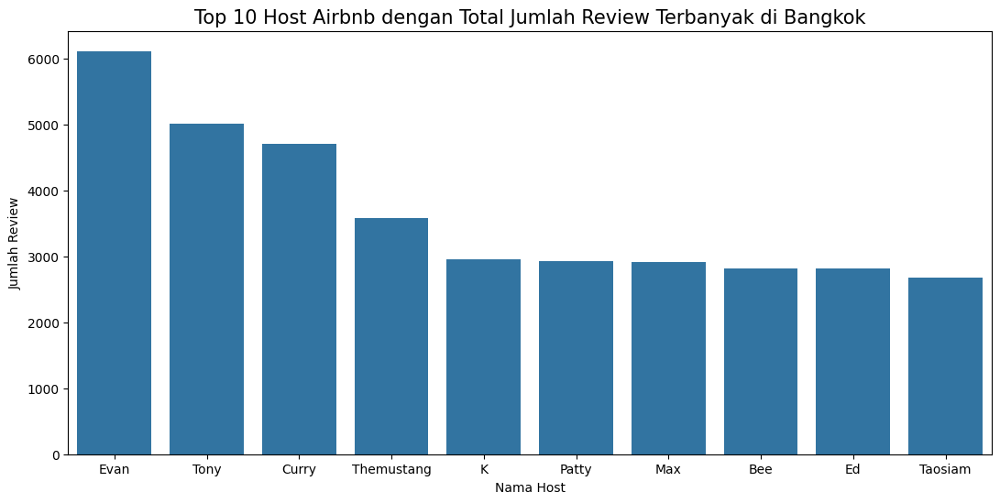

In [123]:
plt.figure(figsize=(13,6))
sns.barplot(data = top_10_host, x = 'host_name', y = 'total_reviews')
plt.title('Top 10 Host Airbnb dengan Total Jumlah Review Terbanyak di Bangkok', size=15)
plt.xlabel('Nama Host')
plt.ylabel('Jumlah Review')
plt.show()

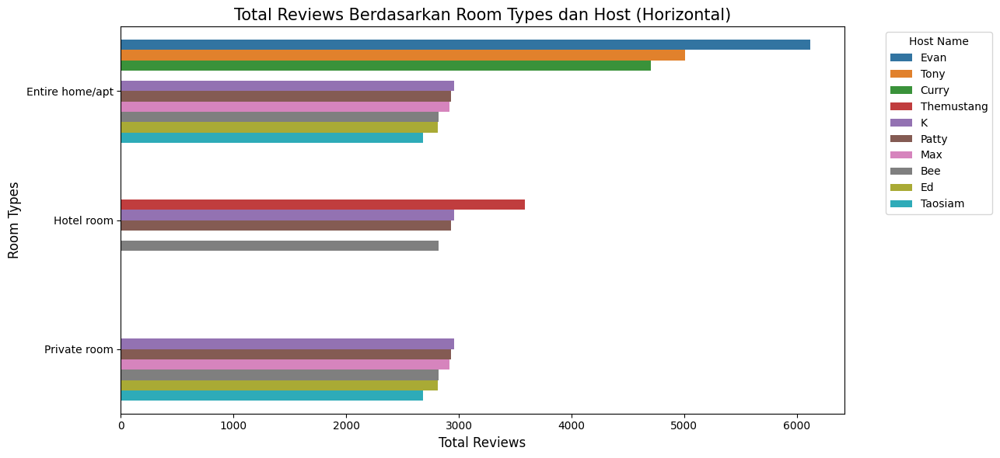

In [ ]:
expanded_data = result_10.assign(
    room_types=result_10['room_types'].str.split(", ")
).explode('room_types')

plt.figure(figsize=(13, 6))
sns.barplot(
    data=expanded_data, 
    x='total_reviews', 
    y='room_types', 
    hue='host_name', 
    palette='tab10'
)

plt.title('Total Reviews Berdasarkan Room Types dan Host (Horizontal)', size=15)
plt.xlabel('Total Reviews', size=12)
plt.ylabel('Room Types', size=12)

plt.legend(title='Host Name', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.show()


Dominasi Room Type "Entire home/apt":
* Tipe kamar "Entire home/apt" mendominasi jumlah ulasan di hampir semua host teratas, menunjukkan preferensi yang signifikan dari pengguna untuk privasi penuh.

Perbedaan Kontribusi Host:
* Host seperti Evan, Tony, dan Curry memiliki kontribusi ulasan yang tinggi dibandingkan host lainnya untuk kategori "Entire home/apt".
Sementara itu, kategori seperti "Hotel room" lebih sedikit jumlah ulasannya dan didominasi oleh host tertentu seperti Themustang.

Diversitas Tipe Kamar:
* Host seperti K, Patty, dan Bee menawarkan beragam tipe kamar, tetapi kontribusi ulasan mereka tersebar lebih merata, sehingga mereka tidak mendominasi satu kategori tertentu.

Host Spesifik Mendominasi Tipe Tertentu:
* Themustang adalah satu-satunya host dengan kontribusi ulasan signifikan pada tipe kamar "Hotel room", menunjukkan spesialisasi mereka dalam tipe ini.

Secara keseluruhan, grafik ini mengindikasikan bahwa preferensi pelanggan cenderung ke "Entire home/apt", sementara diversifikasi tipe kamar lebih sering ditemukan pada host dengan kontribusi ulasan menengah.

## 6. Pendekatan Availability

Menganalisis persentase availability dengan membagi kategori:
* 0 hari (tidak tersedia)
* 1–100 hari (jarang tersedia)
* 101–200 hari (sedang tersedia)
* 201–300 hari (sering tersedia)
* 301–365 hari (selalu tersedia)

Rata-rata Availability: 244.41 hari
                  Category  Count
0             301–365 hari   8263
1             101–200 hari   3001
2               1–100 hari   2487
3             201–300 hari   1246
4  0 hari (Tidak tersedia)    855


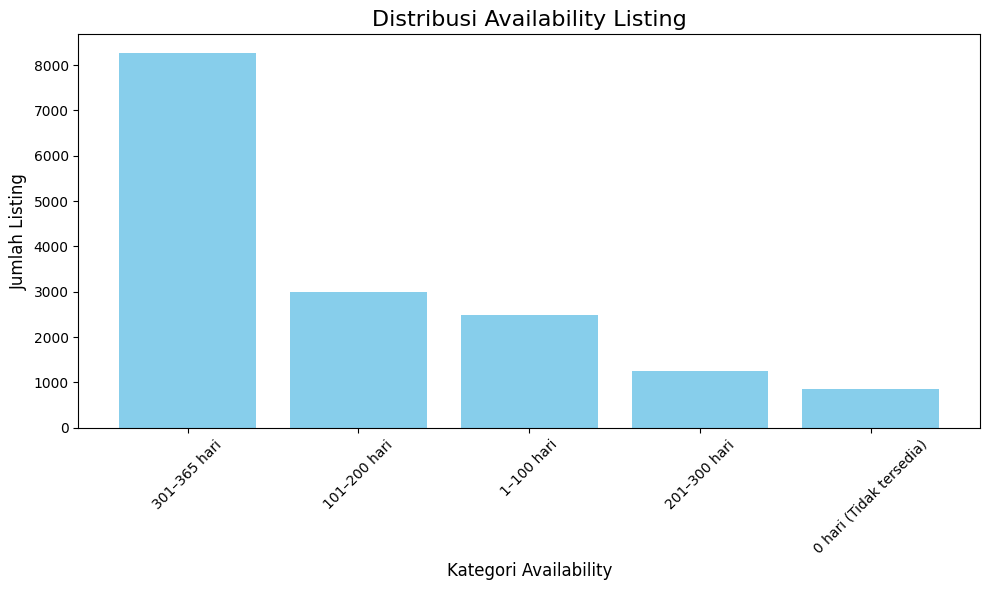

In [ ]:
bins = [0, 0.5, 100, 200, 300, 365]
labels = ["0 hari (Tidak tersedia)", "1–100 hari", "101–200 hari", "201–300 hari", "301–365 hari"]
df['availability_category'] = pd.cut(df['availability_365'], bins=bins, labels=labels, include_lowest=True)

availability_distribution = df['availability_category'].value_counts().reset_index()
availability_distribution.columns = ['Category', 'Count']

average_availability = df['availability_365'].mean()

print(f"Rata-rata Availability: {average_availability:.2f} hari")
print(availability_distribution)

plt.figure(figsize=(10, 6))
plt.bar(availability_distribution['Category'], availability_distribution['Count'], color='skyblue')
plt.title('Distribusi Availability Listing', fontsize=16)
plt.xlabel('Kategori Availability', fontsize=12)
plt.ylabel('Jumlah Listing', fontsize=12)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

Didominasi oleh listing dengan kategori 'selalu tersedia', tapi juga memiliki rata-rata listing 244.41 hari

Lalu menunjukkan rata-rata availability untuk setiap room_type

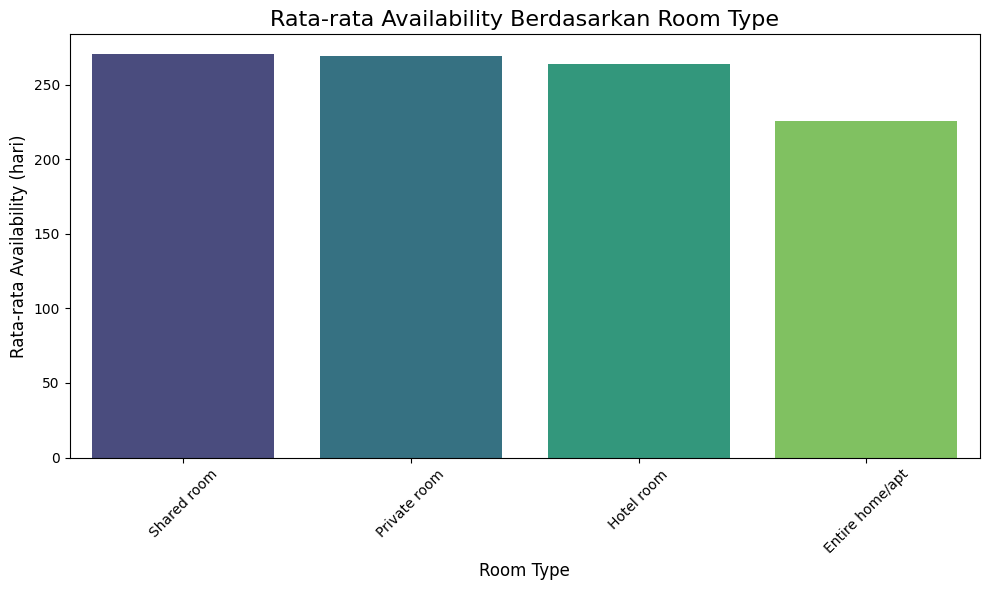

,room_type,availability_365
3,Shared room,270.147228
2,Private room,269.428250
1,Hotel room,263.552469
0,Entire home/apt,225.306812


In [143]:
availability_room_type = df.groupby("room_type")["availability_365"].mean().reset_index()
availability_room_type = availability_room_type.sort_values(by="availability_365", ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(data=availability_room_type, x="room_type", y="availability_365", palette="viridis")
plt.title("Rata-rata Availability Berdasarkan Room Type", fontsize=16)
plt.xlabel("Room Type", fontsize=12)
plt.ylabel("Rata-rata Availability (hari)", fontsize=12)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

availability_room_type

Dari data diatas dapat kita lihat bahwa yang paling banyak ketersediaan room adalah tipe 'shared room', dan yang paling sedikit adalah 'entire home'

Untuk menganalisis hubungan antara availability dan harga, kita bisa melakukannya dengan membagi data ke dalam beberapa rentang harga (price range) untuk melihat tren rata-rata availability.

Rentang harga: Low (<500), Medium (500-1000), High (1000-2000), Very High (2000-5000), Luxury (>5000)


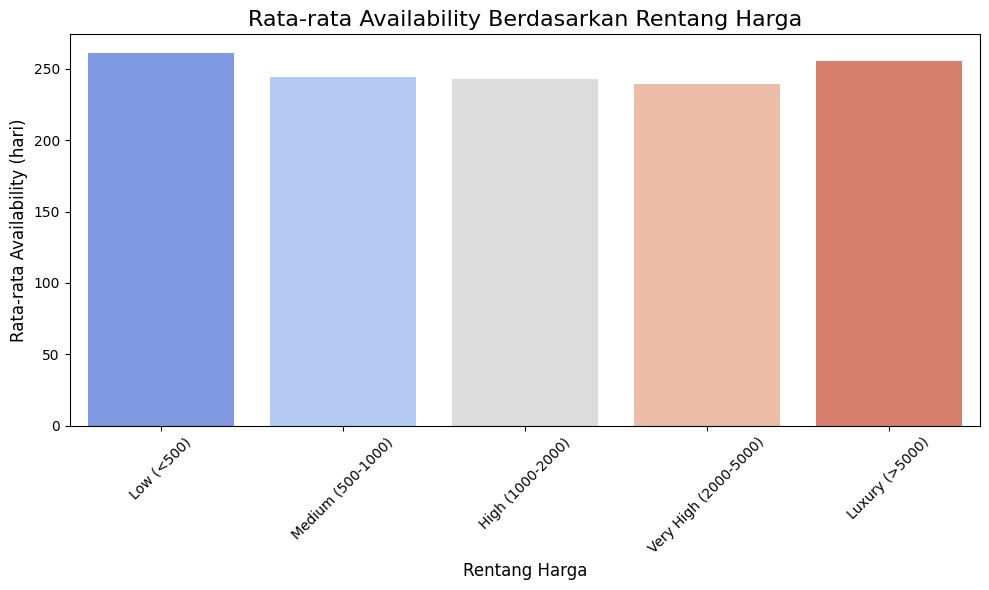

             price_range  availability_365
0             Low (<500)        261.239362
1      Medium (500-1000)        244.236446
2       High (1000-2000)        243.292195
3  Very High (2000-5000)        239.288889
4         Luxury (>5000)        255.381762


In [128]:
# Menambahkan kolom kategori rentang harga
bins = [0, 500, 1000, 2000, 5000, df['price'].max()]
labels = ['Low (<500)', 'Medium (500-1000)', 'High (1000-2000)', 'Very High (2000-5000)', 'Luxury (>5000)']
df['price_range'] = pd.cut(df['price'], bins=bins, labels=labels, right=False)

# Menghitung rata-rata availability berdasarkan rentang harga
availability_price_range = df.groupby("price_range")["availability_365"].mean().reset_index()

# Visualisasi
plt.figure(figsize=(10, 6))
sns.barplot(data=availability_price_range, x="price_range", y="availability_365", palette="coolwarm")
plt.title("Rata-rata Availability Berdasarkan Rentang Harga", fontsize=16)
plt.xlabel("Rentang Harga", fontsize=12)
plt.ylabel("Rata-rata Availability (hari)", fontsize=12)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Menampilkan data dalam tabel
print(availability_price_range)

Dari hasil diatas, dapat dilihat bahwa untuk harga dengan kategori low dan luxury memiliki ketersediaan hari paling tinggi, yang berarti jarang disewa, dan preferensi tamu lebih memilih dengan kategori dari medium-high

Availability terhadap top 10 host

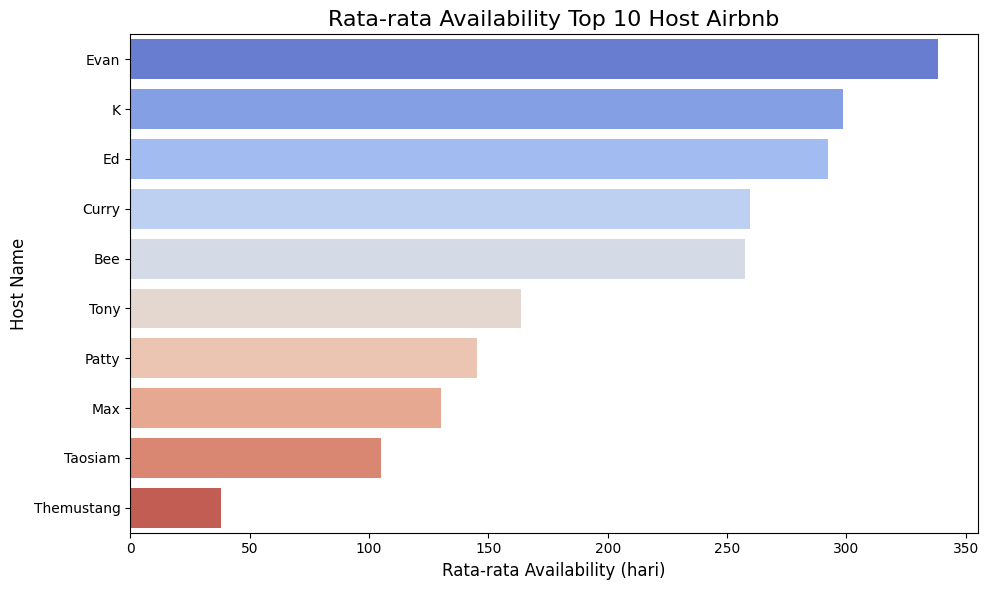

,host_name,avg_availability
3,Evan,338.216216
4,K,298.417582
2,Ed,292.100000
1,Curry,259.478070
0,Bee,257.403226
9,Tony,163.600000
6,Patty,145.462963
5,Max,130.102041
7,Taosiam,104.882353
8,Themustang,38.200000


In [ ]:
top_10_host_availability = df[df["host_name"].isin(top_10_host["host_name"])]

availability_by_host = top_10_host_availability.groupby("host_name").agg(
    avg_availability=("availability_365", "mean")
).reset_index()

availability_by_host = availability_by_host.sort_values(by="avg_availability", ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(
    data=availability_by_host,
    x="avg_availability",
    y="host_name",
    palette="coolwarm"
)
plt.title("Rata-rata Availability Top 10 Host Airbnb", fontsize=16)
plt.xlabel("Rata-rata Availability (hari)", fontsize=12)
plt.ylabel("Host Name", fontsize=12)
plt.tight_layout()
plt.show()

availability_by_host

1. Host dengan Availability Tertinggi
Evan memiliki rata-rata availability tertinggi mendekati 350 hari dalam setahun. Ini menunjukkan properti Evan hampir selalu tersedia sepanjang tahun, mungkin mencerminkan strategi untuk menangkap permintaan maksimal.
2. Host dengan Availability Rendah
Themustang memiliki rata-rata availability paling rendah di antara top 10 host, dengan kurang dari 100 hari. Ini bisa jadi karena:
Properti sering disewakan untuk periode tertentu saja (seasonal availability).
Properti digunakan secara pribadi oleh pemilik untuk sebagian besar waktu dalam setahun.
3. Pola Keseluruhan
Sebagian besar host memiliki availability rata-rata di atas 200 hari, yang mengindikasikan bahwa properti mereka disewakan untuk sebagian besar tahun.
Terdapat variasi yang signifikan dalam strategi availability, dengan beberapa host fokus pada ketersediaan penuh, sementara lainnya membatasi waktu sewa.
4. Strategi yang Mungkin Digunakan oleh Host
Evan, K, dan Ed: Fokus pada ketersediaan tinggi, kemungkinan besar untuk menarik tamu jangka pendek dan memastikan pendapatan maksimal.
Themustang dan Taosiam: Mungkin fokus pada pasar sewa jangka panjang atau memiliki pembatasan dalam jadwal ketersediaan mereka.

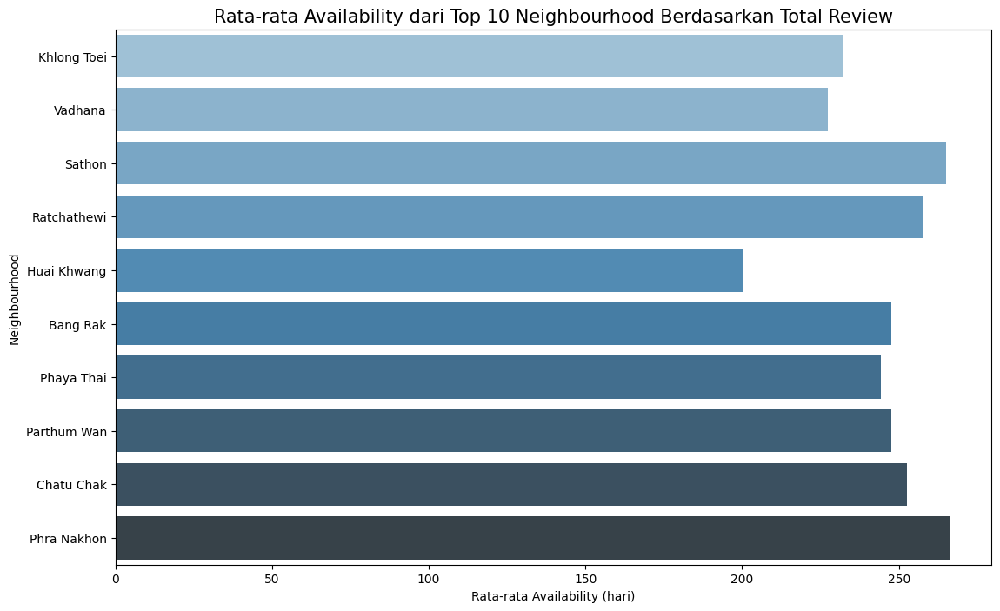

In [144]:
top_neighbourhood_data = df[df['neighbourhood'].isin(top_10_neighbourhoods['neighbourhood'])]

availability_top_neighbourhoods = top_neighbourhood_data.groupby('neighbourhood').agg(
    avg_availability=('availability_365', 'mean')
).reset_index()

top_neighbourhood_availability = pd.merge(
    top_10_neighbourhoods, 
    availability_top_neighbourhoods, 
    on='neighbourhood'
)


top_neighbourhood_availability

plt.figure(figsize=(13, 8))
sns.barplot(
    data=top_neighbourhood_availability,
    x='avg_availability', y='neighbourhood',
    palette="Blues_d"
)
plt.title("Rata-rata Availability dari Top 10 Neighbourhood Berdasarkan Total Review", size=15)
plt.xlabel("Rata-rata Availability (hari)")
plt.ylabel("Neighbourhood")
plt.show()

Neighbourhood Khlong Toei memiliki rata-rata availability tertinggi di antara 10 besar neighbourhood dengan total ulasan terbanyak, menunjukkan properti di area ini lebih sering untuk disewa. Sebaliknya, Phra Nakhon memiliki rata-rata availability terendah, mengindikasikan tingkat sewa yang rendah.

## 7. Pendekatan Minimum Nights

Distribusi Minimum Night:

Analisis distribusi minimum night untuk mendapatkan gambaran umum.
Bisa digunakan histogram atau boxplot.

In [131]:
df['minimum_nights'].describe()

count    15852.000000
mean        15.223253
std         50.047830
min          1.000000
25%          1.000000
50%          1.000000
75%          7.000000
max       1115.000000
Name: minimum_nights, dtype: float64

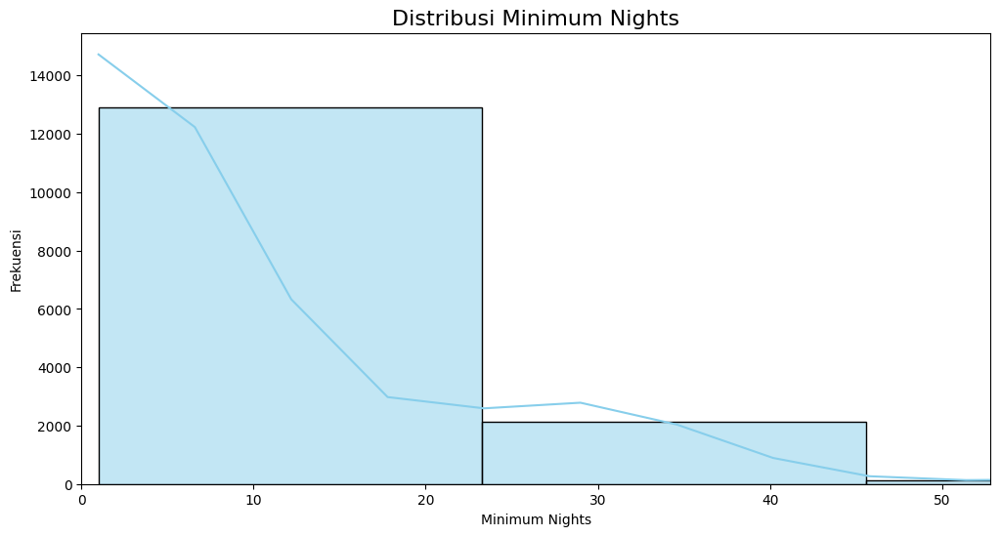

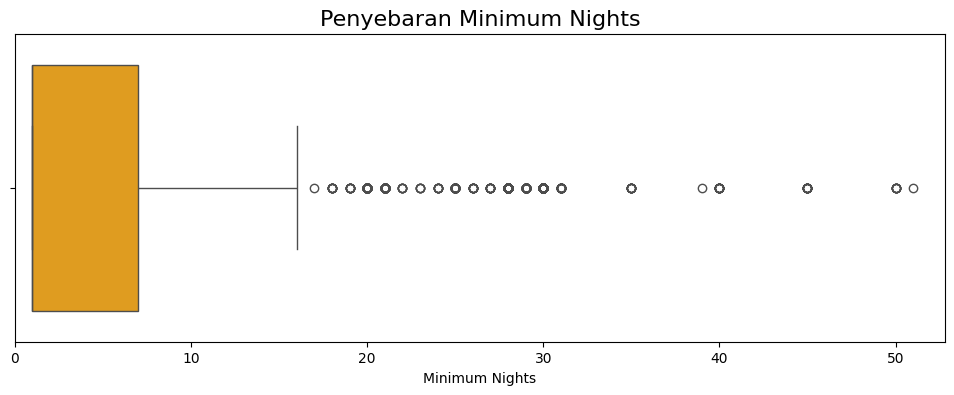

In [ ]:
plt.figure(figsize=(12, 6))
sns.histplot(df['minimum_nights'], bins=50, kde=True, color='skyblue')
plt.title('Distribusi Minimum Nights', fontsize=16)
plt.xlabel('Minimum Nights')
plt.ylabel('Frekuensi')
plt.xlim(0, df['minimum_nights'].quantile(0.95))  # Membatasi tampilan outlier
plt.show()

plt.figure(figsize=(12, 4))
sns.boxplot(x=df['minimum_nights'], color='orange')
plt.title('Penyebaran Minimum Nights', fontsize=16)
plt.xlabel('Minimum Nights')
plt.xlim(0, df['minimum_nights'].quantile(0.95))  # Membatasi tampilan outlier
plt.show()

Dari histogram distribusi Minimum Nights, berikut beberapa insight yang dapat ditarik:

Mayoritas Listing Memiliki Minimum Nights Rendah:
* Sebagian besar listing memiliki nilai minimum_nights yang rendah, terutama antara 1 hingga 10 malam.
Ini menunjukkan bahwa banyak host menargetkan pasar short-stay travelers (wisatawan yang menginap dalam waktu singkat).

Distribusi Tidak Merata (Right-Skewed):
* Distribusi sangat miring ke kanan (right-skewed), dengan sebagian kecil listing memiliki minimum_nights yang jauh lebih tinggi (20 malam atau lebih).
Listing ini mungkin menargetkan pasar long-stay travelers (penginapan jangka panjang) atau memiliki peraturan ketat untuk pemesanan.

Potensi Outlier:
* Beberapa listing dengan minimum_nights sangat tinggi (lebih dari 30 atau bahkan 50 malam) dapat dianggap sebagai outlier.
Hal ini bisa disebabkan oleh strategi host untuk menghindari penyewa jangka pendek

Hubungan Minimum night dengan price

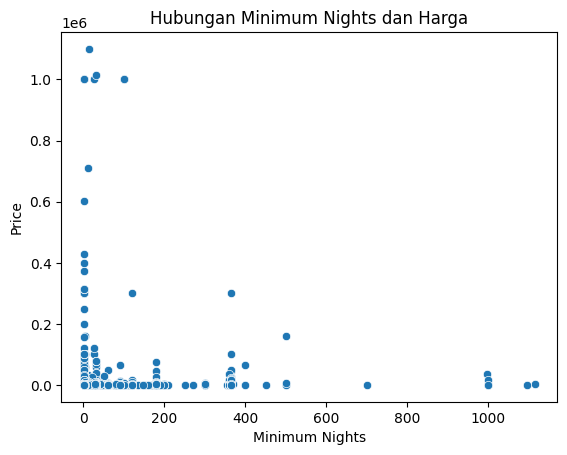

In [133]:
sns.scatterplot(x='minimum_nights', y='price', data=df)
plt.title('Hubungan Minimum Nights dan Harga')
plt.xlabel('Minimum Nights')
plt.ylabel('Price')
plt.show()

Mayoritas Harga Berada di Kisaran Rendah:
* Sebagian besar listing dengan minimum_nights rendah (1–50 malam) memiliki harga yang relatif rendah, terlihat berkumpul di area bawah grafik.
Ini menandakan bahwa host yang menetapkan minimum_nights rendah cenderung bersaing dengan harga yang lebih terjangkau.

Outlier di Harga Sangat Tinggi:
* Ada beberapa outlier dengan harga sangat tinggi (mencapai lebih dari 1 juta), bahkan untuk listing dengan minimum_nights rendah.
Outlier ini bisa jadi properti mewah atau listing khusus yang menargetkan pasar premium.

Hubungan Lemah Antara Minimum Nights dan Harga:
* Tidak ada pola yang jelas antara minimum_nights dan price. Nilai harga tinggi maupun rendah muncul di berbagai rentang minimum_nights.
Ini menunjukkan bahwa harga lebih dipengaruhi oleh faktor lain, seperti lokasi, tipe ruangan, atau fasilitas, daripada jumlah malam minimum.

Tipe room dengan avg minimum night

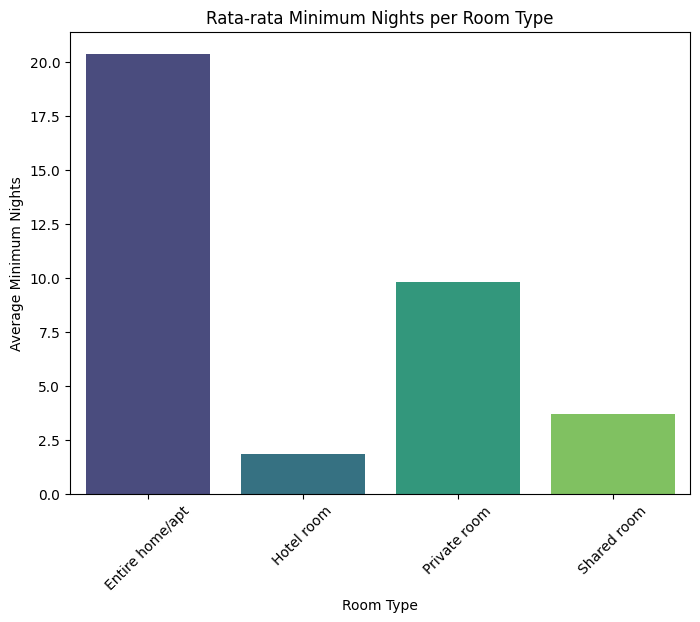

In [146]:
avg_minimum_nights_per_room_type = df.groupby('room_type')['minimum_nights'].mean().reset_index()


avg_minimum_nights_per_room_type

import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(8, 6))
sns.barplot(x='room_type', y='minimum_nights', data=avg_minimum_nights_per_room_type, palette='viridis')
plt.title('Rata-rata Minimum Nights per Room Type')
plt.xlabel('Room Type')
plt.ylabel('Average Minimum Nights')
plt.xticks(rotation=45)
plt.show()


* Entire Home/Apt Memiliki Minimum Nights Tertinggi: Properti tipe ini cenderung menargetkan penyewaan jangka menengah hingga panjang, dengan rata-rata minimum nights jauh lebih tinggi dibandingkan tipe lainnya.

* Hotel Room dan Shared Room Fokus pada Penyewaan Singkat: Kedua tipe ini memiliki rata-rata minimum nights yang rendah, ideal untuk wisatawan jangka pendek dengan kebutuhan fleksibilitas dan anggaran terbatas.

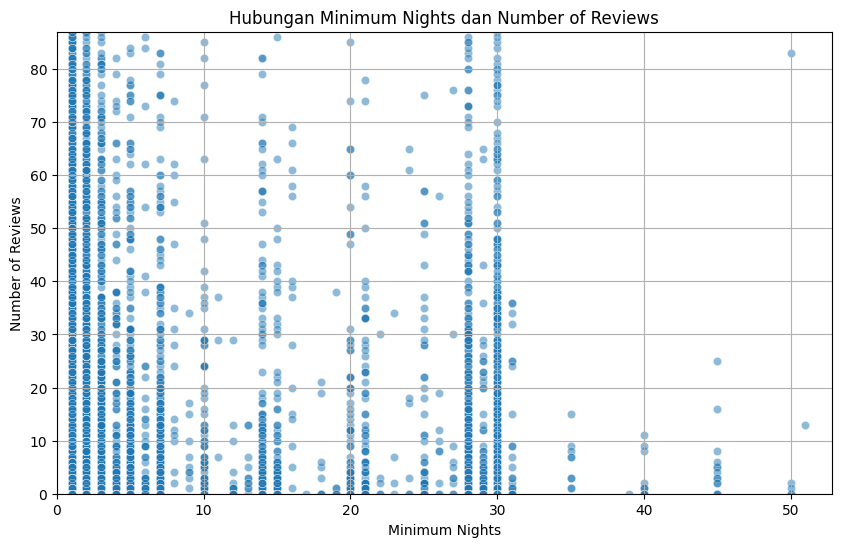

In [ ]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='minimum_nights', y='number_of_reviews', data=df, alpha=0.5)

plt.title('Hubungan Minimum Nights dan Number of Reviews')
plt.xlabel('Minimum Nights')
plt.ylabel('Number of Reviews')
plt.xlim(0, df['minimum_nights'].quantile(0.95))  
plt.ylim(0, df['number_of_reviews'].quantile(0.95)) 
plt.grid(True)
plt.show()

* Properti dengan jumlah minimum nights rendah (0–10 malam) cenderung memiliki lebih banyak ulasan. Hal ini mungkin menunjukkan bahwa durasi menginap yang lebih fleksibel menarik lebih banyak tamu dan menghasilkan lebih banyak ulasan.
* Properti dengan minimum nights tinggi (lebih dari 30 malam) memiliki jumlah ulasan yang relatif lebih sedikit, yang dapat mengindikasikan bahwa durasi minimum yang panjang kurang populer di kalangan tamu.

Minimum Nights di top 10 neighbourhood

In [ ]:
top_neighbourhood_data = df[df['neighbourhood'].isin(top_10_neighbourhoods['neighbourhood'])]

average_minimum_nights = top_neighbourhood_data.groupby('neighbourhood')['minimum_nights'].mean().reset_index()

average_minimum_nights = average_minimum_nights.sort_values(by='minimum_nights', ascending=False)

average_minimum_nights


,neighbourhood,minimum_nights
1,Chatu Chak,21.313869
4,Parthum Wan,18.552863
2,Huai Khwang,16.176000
9,Vadhana,15.506041
3,Khlong Toei,14.099666
7,Ratchathewi,13.382406
8,Sathon,13.322621
0,Bang Rak,12.350665
5,Phaya Thai,11.627962
6,Phra Nakhon,1.337641


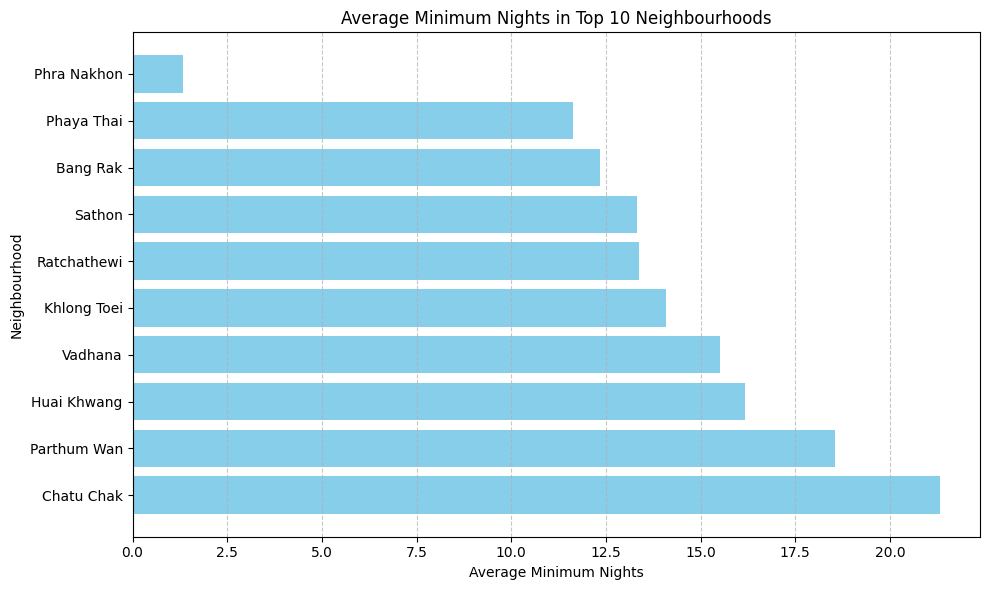

In [ ]:
plt.figure(figsize=(10, 6))
plt.barh(average_minimum_nights['neighbourhood'], average_minimum_nights['minimum_nights'], color='skyblue')
plt.xlabel('Average Minimum Nights')
plt.ylabel('Neighbourhood')
plt.title('Average Minimum Nights in Top 10 Neighbourhoods')
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

* Chatu Chak memiliki rata-rata minimum malam tertinggi (>20 malam), sedangkan Phra Nakhon terendah. Kawasan lain bervariasi antara 10-18 malam.
* Chatu Chak: Fokus pada sewa jangka panjang karena mungkin dekat dengan area residensial atau pusat bisnis.
* Phra Nakhon: Destinasi turis, sehingga lebih fleksibel untuk sewa jangka pendek.
* Kawasan lain: Kombinasi kebutuhan turis dan penyewa jangka menengah.

Minimum Night berdasarkan Top 10 Host

In [ ]:
top_10_host_names = top_10_host['host_name']
df_top_10 = df[df['host_name'].isin(top_10_host_names)]

min_nights_stats = df_top_10.groupby('host_name')['minimum_nights'].describe()
min_nights_stats

,count,mean,std,min,25%,50%,75%,max
host_name,,,,,,,,
Bee,62.0,7.596774,14.252362,1.0,1.0,2.0,6.5,90.0
Curry,228.0,2.460526,4.385923,1.0,1.0,1.0,3.0,30.0
Ed,60.0,2.966667,8.507159,1.0,1.0,1.0,1.0,51.0
Evan,37.0,1.108108,0.657596,1.0,1.0,1.0,1.0,5.0
K,91.0,4.527473,7.362579,1.0,1.0,1.0,1.0,45.0
Max,49.0,19.469388,14.684320,1.0,2.0,30.0,30.0,55.0
Patty,54.0,6.574074,17.809900,1.0,1.0,1.0,3.0,90.0
Taosiam,34.0,1.000000,0.000000,1.0,1.0,1.0,1.0,1.0
Themustang,10.0,1.000000,0.000000,1.0,1.0,1.0,1.0,1.0


In [147]:
top_10_host = top_10_host.merge(
    df.groupby('host_name')['minimum_nights'].mean().reset_index(),
    on='host_name'
).rename(columns={'minimum_nights': 'avg_minimum_nights'})

top_10_host[['host_name', 'total_reviews', 'avg_minimum_nights']]

,host_name,total_reviews,avg_minimum_nights,avg_minimum_nights
0,Evan,6117,1.108108,1.108108
1,Tony,5010,1.820000,1.820000
2,Curry,4708,2.460526,2.460526
3,Themustang,3584,1.000000,1.000000
4,K,2962,4.527473,4.527473
5,Patty,2929,6.574074,6.574074
6,Max,2915,19.469388,19.469388
7,Bee,2823,7.596774,7.596774
8,Ed,2817,2.966667,2.966667
9,Taosiam,2681,1.000000,1.000000


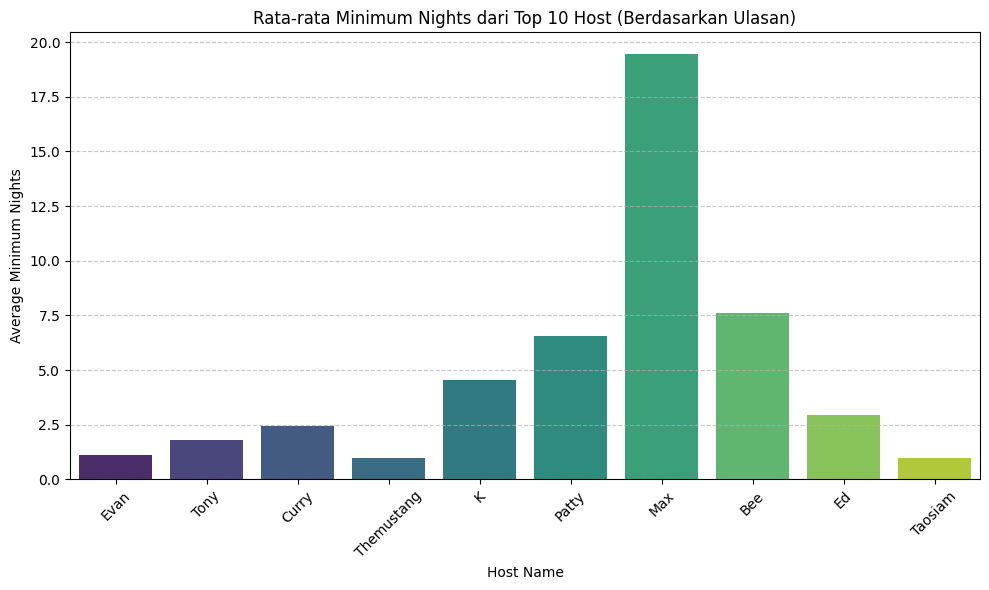

In [ ]:
plt.figure(figsize=(10, 6))
sns.barplot(
    data=top_10_host,
    x='host_name',
    y='avg_minimum_nights',
    order=top_10_host['host_name'],
    palette='viridis'
)

plt.title('Rata-rata Minimum Nights dari Top 10 Host (Berdasarkan Ulasan)')
plt.xlabel('Host Name')
plt.ylabel('Average Minimum Nights')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

Dari top 10 host, mereka menawarkan minimum night yang rendah (1 hari), sehingga memungkinkan para tamu yang memerlukan sewa dalam waktu singkat memilih list tersebut

# Kesimpulan dan Rekomendasi

## Kesimpulan

Setelah melakukan analisis dengan berbagai pendekatan, dapat diambil kesimpulan yaitu:
1. Distribusi Airbnb di Bangkok cukup merata, namun terpusat di distrik pusat kota seperti Vadhana dan Khlong Toei yang mendominasi dengan fasilitas modern, akses transportasi, dan lokasi strategis. Distrik populer lainnya seperti Huai Khwang dan Sathon menawarkan daya tarik unik seperti kuliner lokal dan kawasan bisnis, sementara distrik menengah seperti Phra Nakhon menarik wisatawan yang mencari pengalaman berbeda seperti area backpacker Khao San Road. Sebaliknya, distrik suburban seperti Nong Chok memiliki listing rendah karena keterbatasan akses dan atraksi. Pola ini mencerminkan preferensi wisatawan terhadap lokasi dengan aksesibilitas, fasilitas lengkap, dan daya tarik wisata utama.

2. Tipe "Entire home/apt" mendominasi pilihan pengguna Airbnb di Bangkok, terlihat dari jumlah review yang jauh lebih tinggi dibandingkan tipe lainnya, menunjukkan preferensi tamu terhadap privasi dan kenyamanan, terutama untuk keluarga atau kelompok. "Private room" juga cukup populer, menawarkan opsi lebih terjangkau dengan privasi yang memadai. Sementara itu, "Hotel room" dan "Shared room" memiliki review yang jauh lebih sedikit, kemungkinan karena ketersediaan terbatas atau preferensi yang lebih rendah di kalangan tamu.

3. Harga listing Airbnb di Bangkok menunjukkan variasi signifikan antar neighbourhood, dengan Bang Phlat sebagai area premium (harga rata-rata >6000) dan Lak Si sebagai area terjangkau (<1000). Sebagian besar neighbourhood memiliki harga di bawah 3000, menandakan area dengan harga tinggi adalah pengecualian. Segmentasi harga untuk tiap tipe room cukup jelas sesuai dengan kenyamanan yang diberikan. Popularitas listing (berdasarkan jumlah ulasan) tidak berkorelasi dengan harga tinggi, mencerminkan preferensi tamu terhadap akomodasi yang sesuai anggaran. Korelasi harga dengan variabel lain, seperti minimum nights dan availability, sangat rendah, menunjukkan independensi antar faktor. Sementara itu, jumlah ulasan memiliki korelasi moderat dengan ulasan per bulan (r = 0.57), mencerminkan pola konsistensi ulasan pada properti populer.

4. Pasar Airbnb di Bangkok menunjukkan pertumbuhan pesat sejak akhir pandemi, dengan lonjakan signifikan jumlah review pada 2022 sebagai tanda pemulihan besar-besaran di sektor pariwisata. Aktivitas puncak terjadi pada Desember 2022, khususnya menjelang pertengahan bulan, kemungkinan dipengaruhi oleh musim liburan dan peningkatan perjalanan wisatawan domestik maupun internasional. Sebelum 2020, pasar berkembang lambat, dengan dampak pandemi terlihat jelas pada fluktuasi rendah selama 2020-2021.

5. Tipe kamar "Entire home/apt" mendominasi ulasan, menegaskan preferensi pengguna terhadap privasi penuh, terutama dengan kontribusi ulasan besar dari host seperti Evan, Tony, dan Curry. Di sisi lain, tipe kamar "Hotel room" memiliki ulasan jauh lebih sedikit dan didominasi oleh satu host utama, Themustang, yang menunjukkan fokus khusus pada kategori ini. Host seperti K, Patty, dan Bee cenderung menawarkan berbagai tipe kamar dengan ulasan yang tersebar lebih merata, mencerminkan strategi diversifikasi mereka. Secara keseluruhan, data ini menyoroti dominasi "Entire home/apt" sebagai pilihan favorit pengguna, sementara host dengan kontribusi menengah lebih mengutamakan variasi untuk menjangkau lebih banyak segmen pelanggan.

6. Data ini menunjukkan bahwa mayoritas listing termasuk dalam kategori "selalu tersedia," dengan rata-rata ketersediaan 244,41 hari per tahun. Tipe kamar "shared room" memiliki ketersediaan hari tertinggi, sedangkan "entire home" paling rendah. Analisis rentang harga mengungkap bahwa listing dengan harga rendah (<500) dan mewah (>5000) memiliki ketersediaan tinggi, yang berarti jarang disewa, sedangkan kategori harga "medium-high" (500-2000) lebih diminati tamu. Host seperti Evan memaksimalkan ketersediaan hingga mendekati 350 hari per tahun, sedangkan host seperti Themustang memiliki rata-rata di bawah 100 hari, yang mungkin mencerminkan strategi sewa musiman atau penggunaan pribadi. Di tingkat wilayah, Khlong Toei menonjol dengan ketersediaan tertinggi, sedangkan Phra Nakhon memiliki ketersediaan terendah. Data ini mencerminkan perbedaan strategi host dan preferensi pasar berdasarkan ketersediaan dan harga.

7. Mayoritas listing memiliki minimum nights rendah (1–10 malam), menargetkan wisatawan short-stay dengan harga yang lebih terjangkau, sementara listing dengan minimum nights tinggi (>30 malam) sering kali menargetkan penyewaan jangka panjang atau menghindari tamu jangka pendek. Distribusi minimum nights bersifat miring ke kanan dengan outlier berupa listing berharga tinggi yang menargetkan pasar premium. Tipe entire home/apt cenderung memiliki minimum nights lebih tinggi, sementara hotel room dan shared room fokus pada durasi singkat. Properti dengan durasi fleksibel (0–10 malam) cenderung memiliki lebih banyak ulasan, menandakan popularitas di kalangan tamu. Secara wilayah, Chatu Chak menonjol dengan rata-rata durasi sewa lebih tinggi (>20 malam), sedangkan Phra Nakhon, sebagai destinasi turis, memiliki durasi terendah, mencerminkan kebutuhan yang berbeda antar lokasi.

## Rekomendasi

1. Distribusi Airbnb di Bangkok

* Fokus pemasaran pada distrik pusat kota seperti Vadhana dan Khlong Toei, yang memiliki fasilitas modern dan akses transportasi, untuk menarik lebih banyak wisatawan.

* Promosikan daya tarik unik distrik seperti Huai Khwang (kuliner lokal) dan Sathon (kawasan bisnis) untuk meningkatkan popularitas area tersebut.

* Untuk distrik suburban seperti Nong Chok, dorong kerjasama dengan atraksi lokal atau perbaiki aksesibilitas untuk meningkatkan daya tarik.

2. Dominasi Tipe "Entire home/apt"

* Tingkatkan penawaran "Entire home/apt" untuk memenuhi preferensi tamu yang mengutamakan privasi, terutama keluarga dan kelompok.

* Promosikan "Private room" sebagai opsi lebih terjangkau dengan tetap menjaga privasi, ideal untuk tamu solo atau pasangan.

* Tawarkan paket promosi khusus untuk "Hotel room" dan "Shared room" untuk menarik segmen wisatawan anggaran rendah.

3. Variasi Harga Listing Airbnb

* Segmentasikan harga listing berdasarkan neighbourhood untuk menargetkan pelanggan yang berbeda, seperti pasar premium di Bang Phlat atau anggaran rendah di Lak Si.

* Optimalisasi listing harga kategori "medium-high" (500-2000) karena paling diminati tamu, sambil menawarkan nilai tambah seperti fasilitas tambahan untuk bersaing dengan listing lain.

* Analisis lebih lanjut faktor seperti fasilitas dan lokasi untuk mengidentifikasi penyebab preferensi tamu yang tidak terpengaruh oleh minimum nights dan availability.

4. Tren Pertumbuhan Pasar Pasca-Pandemi

* Lakukan kampanye pemasaran besar-besaran menjelang musim liburan (seperti Desember) untuk memanfaatkan lonjakan aktivitas wisata.

* Kerjasama dengan agen perjalanan domestik dan internasional untuk menarik wisatawan di periode puncak pariwisata.

* Tingkatkan strategi promosi untuk listing yang baru bergabung agar dapat bersaing di pasar yang semakin kompetitif.

5. Strategi Host Berdasarkan Tipe Kamar

* Dorong host untuk menawarkan lebih banyak "Entire home/apt" untuk memenuhi permintaan tinggi dan memaksimalkan potensi ulasan.

* Berikan panduan diversifikasi kepada host seperti K, Patty, dan Bee, untuk menjangkau segmen pasar yang lebih luas dengan berbagai tipe kamar.

* Host spesialis "Hotel room" seperti Themustang dapat meningkatkan ketersediaan untuk menjangkau lebih banyak tamu.

6. Strategi Ketersediaan Listing

* Host dengan kategori "selalu tersedia" dapat meningkatkan daya saing dengan memberikan diskon musiman atau promosi untuk mengisi periode kosong.

* Tawarkan panduan bagi host tipe "shared room" untuk meningkatkan fleksibilitas harga guna meningkatkan tingkat okupansi.

* Untuk wilayah dengan ketersediaan rendah seperti Phra Nakhon, dorong listing baru atau kemitraan dengan penyedia akomodasi lokal untuk meningkatkan kapasitas.

7. Strategi Berdasarkan Minimum Nights

* Host dengan minimum nights rendah (1-10 malam) dapat mengoptimalkan listing dengan promosi untuk wisatawan short-stay.

* Untuk listing dengan minimum nights tinggi (>30 malam), dorong strategi seperti penawaran bulanan dengan diskon untuk menarik tamu jangka panjang.

* Promosikan listing dengan durasi fleksibel di wilayah wisata populer seperti Phra Nakhon untuk meningkatkan ulasan dan daya tarik wisatawan.

* Tingkatkan pemasaran di Chatu Chak dengan menargetkan wisatawan jangka panjang, misalnya ekspatriat atau pelajar internasional.